**Student:** Capatina Razvan-Nicolae
<br>
**Group:** 407 AI

Mount Google Drive for Graph Data

In [ ]:
from google.colab import drive
import os

drive.mount('/content/drive', force_remount=True)

print(os.getcwd())

Mounted at /content/drive
/content


Dependencies

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pymc as pm
import arviz as az
import networkx as nx
import pickle
import pandas as pd
import os
import warnings

%config InlineBackend.figure_format = 'retina'
az.style.use('arviz-darkgrid')

warnings.filterwarnings('ignore')

MAIN_FOLDER_PATH = '/content/drive/MyDrive/Project-Probabilistic-Programming-PP'

## Exercise 1

Read Graph Data

In [ ]:
graph_ex1 = pickle.load(open(MAIN_FOLDER_PATH + '/ex_1_graph.pickle', 'rb'))

Graph Visualization

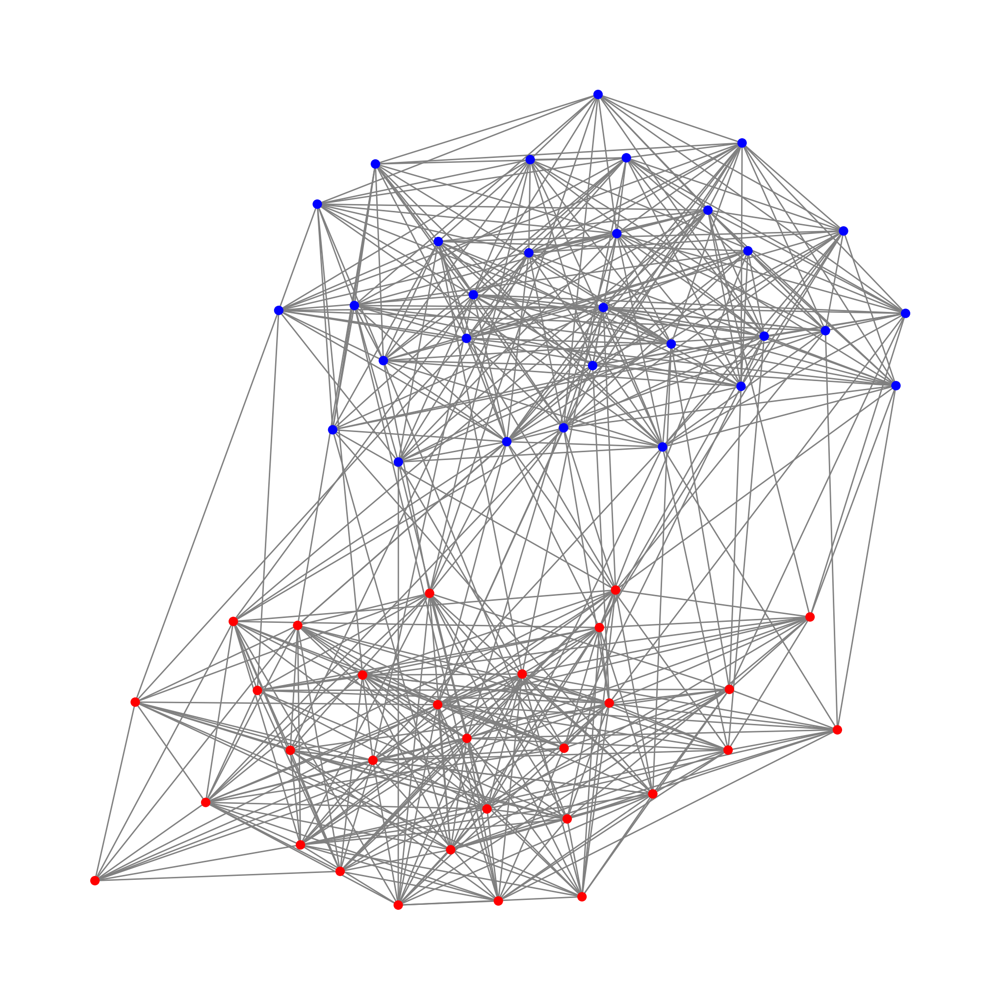

In [ ]:
plt.figure(figsize=(10, 10))
positions = nx.spring_layout(graph_ex1, seed=23)
# blue for faction A, red for B
node_colors = ['blue' if node_data['faction'] == 'A' else 'red' for _, node_data in graph_ex1.nodes(data=True)]
nx.draw(graph_ex1, pos=positions, node_color=node_colors, edge_color='gray', node_size=35)
plt.show()

In [ ]:
# Here we build the adjacency matrix of the graph. Since the graph is undirected, we add the messages parameter for both mat[i, j] and mat[j, i].
# The matrix is therefore symmetrical.

adjacency_matrix_ex1 = np.zeros((len(graph_ex1.nodes), len(graph_ex1.nodes)))
for node_0, node_1, edge_data in graph_ex1.edges(data=True):
    adjacency_matrix_ex1[node_0, node_1] += edge_data['messages']
    adjacency_matrix_ex1[node_1, node_0] += edge_data['messages']

print('Adjacency Matrix:')
print(adjacency_matrix_ex1)

Adjacency Matrix:
[[ 0. 21. 37. ...  0.  0.  0.]
 [21.  0. 21. ...  0.  3.  0.]
 [37. 21.  0. ...  0.  0.  0.]
 ...
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  3.  0. ...  0.  0. 26.]
 [ 0.  0.  0. ...  0. 26.  0.]]


In [ ]:
# Here we obtain all the ordered pairs (A, B) of nodes from the graph.
# k = 1 for np.triu_indices, which means we exclude the diagonal (in our case, pairs of form (A, A)).

node_indices_0_ex1, node_indices_1_ex1 = np.triu_indices(len(graph_ex1.nodes), k=1)
observed_adjacency_ex1 = adjacency_matrix_ex1[node_indices_0_ex1, node_indices_1_ex1]

model_coordinates_ex1 = {
    'nodes': list(graph_ex1.nodes),
    'node_dims': ['x', 'y'],
    'edges': np.arange(len(observed_adjacency_ex1))
}

### Exercise 1:

&emsp; We have an undirected graph with weights on edges (under the form of number of messages between politicians/nodes).

&emsp; First, we can consider that the prior distribution of the 2D latent positions is a 2D Gaussian Distribution with mean 0 and a standard deviation of 1. This is useful, since it will promote the points to have coordinates near 0, while also will not restrict their range (the coordinates can have any value, Gaussian Distribution has as support the entire real number line). Small values will be preffered and therefore the coordinates will somehow be standardized and numerically stable for future computations.
<br>
<br>
&emsp; If we instead used an Uniform Distribution, this would have restricted the range of possible values the points can have and will also make the sampling more time consuming, since the Uniform Distribution is a less informative prior.

&emsp; We will use a similar linear combination from one described in the paper "Latent Space Approaches to Social Network Analysis", by Peter D. Hoff, Adrian E. Raftery, and Mark S. Handcock. Our version will consider that there is no covariate information between nodes and we will also add a parameter for the distance variable. Therefore, the linear combination will be
<br>
<br>
$$\text{a_coeff - b_coeff}\times\text{node_distances}$$
<br>
,where a_coeff will be sampled from a prior Gaussian Distribution of mean 0 and standard deviation 2, while b_coeff will be sampled from a Half Gaussian with standard deviation 2.
<br>
<br>
&emsp; We can see that since b_coeff will always be $\ge 0$, this means that b_coeff * node_distances $\ge 0$ and the linear combination will become smaller as the distance between the nodes grows larger.
<br>
<br>
&emsp; This linear combination is then used in $e^{\text{a_coeff - b_coeff}\times\text{node_distances}}$, a monotone function that takes lower values as the distances between nodes grows.

&emsp; In the end, the number of messages between politicians is represented by a Poisson Distribution (a distribution with discrete range $\{0, 1, 2, \ldots\}$, containing all positive integers values, where lower values are more probable). This distribution is suitable for our problem, since the number of messages are integer values $\ge 0$ and the Poisson Distribution by definition represents the number of times an event (in our case, a message between two fixed politicians) occurs in a fixed time interval. Also, the distribution does not impose a limit on the right side of the number line, unlike other possible candidate distributions, such as Binomial Distribution.
<br>
<br>
&emsp; This Poisson Distribution will use as mean the result of the $e^{\text{a_coeff - b_coeff}\times\text{node_distances}}$ expression, which will represent that we have greater probability to have large number of messages between two politicians if the distance between them in the latent 2D space is small.
<br>
<br>
&emsp; In the end, for the Poisson Distribution, the observed data will be the original adjacency matrix values from the input graph.

In [ ]:
def distance_model_mcmc_approach(model_coordinates, graph, observed_adjacency, node_indices_0, node_indices_1):
  # This function computes a probabilistic model that will provide the latent 2D positions of the nodes from the original graph.

  with pm.Model(coords=model_coordinates) as model:
    node_positions = pm.Normal('node_positions', mu=0.0, sigma=1.0, dims=('nodes', 'node_dims'))

    a_coeff = pm.Normal('a_coeff', mu=0.0, sigma=2.0)
    b_coeff = pm.HalfNormal('b_coeff', sigma=2.0)

    # Euclidian distance was used for computing node_distances.
    node_distances = pm.math.sqrt(pm.math.sum((node_positions[node_indices_0] - node_positions[node_indices_1])**2, axis=1))
    adjacency = pm.math.exp(a_coeff - b_coeff * node_distances)

    observed_adjacency_likelyhood = pm.Poisson('observed_adjacency_likelyhood', mu=adjacency, observed=observed_adjacency)

    i_data = pm.sample(draws=2000, tune=500, chains=1, target_accept=0.9, random_seed=23)

  az.plot_trace(i_data, var_names=['a_coeff', 'b_coeff'])
  az.summary(i_data, var_names=['a_coeff', 'b_coeff'])

  # Here we obtain a fixed value for the latent 2D positions by taking the mean across all chains and draws that we have done.
  node_positions_posterior = i_data.posterior['node_positions'].mean(dim=('chain', 'draw')).values

  # Here we obtain fixed values for the a_coeff and b_coeff parameters by taking the mean of their respective distributions.
  a_coeff_posterior = i_data.posterior['a_coeff'].mean().values
  b_coeff_posterior = i_data.posterior['b_coeff'].mean().values

  # Here we compute the posterior adjacency matrix (it should reflect as much as possible the original adjacency matrix from the input graph).
  # We compute it by using the fixed parameters a_coeff and b_coeff and same formula from the probabilistic model.
  adjacency_matrix_posterior = np.zeros((len(graph.nodes), len(graph.nodes)))
  for node_0 in range(len(graph.nodes)):
    for node_1 in range(node_0 + 1, len(graph.nodes)):
        node_distance = np.sqrt(np.sum((node_positions_posterior[node_0] - node_positions_posterior[node_1])**2))
        adjacency = np.exp(a_coeff_posterior - b_coeff_posterior * node_distance)
        adjacency_matrix_posterior[node_0, node_1] = adjacency
        adjacency_matrix_posterior[node_1, node_0] = adjacency

  return model, i_data, node_positions_posterior, adjacency_matrix_posterior


def distance_model_mcmc_approach_loaded(graph, i_data):
  # This function does the same thing as the one from above, but it receives the i_data directly as parameter.
  # It is useful if we load the i_data from disk and we directly compute the parameters of the model (a_coeff and b_coeff).

  az.plot_trace(i_data, var_names=['a_coeff', 'b_coeff'])
  az.summary(i_data, var_names=['a_coeff', 'b_coeff'])

  node_positions_posterior = i_data.posterior['node_positions'].mean(dim=('chain', 'draw')).values

  a_coeff_posterior = i_data.posterior['a_coeff'].mean().values
  b_coeff_posterior = i_data.posterior['b_coeff'].mean().values

  adjacency_matrix_posterior = np.zeros((len(graph.nodes), len(graph.nodes)))
  for node_0 in range(len(graph.nodes)):
    for node_1 in range(node_0 + 1, len(graph.nodes)):
        node_distance = np.sqrt(np.sum((node_positions_posterior[node_0] - node_positions_posterior[node_1])**2))
        adjacency = np.exp(a_coeff_posterior - b_coeff_posterior * node_distance)
        adjacency_matrix_posterior[node_0, node_1] = adjacency
        adjacency_matrix_posterior[node_1, node_0] = adjacency

  return node_positions_posterior, adjacency_matrix_posterior

Output()

Shape validation failed: input_shape: (1, 2000), minimum_shape: (chains=2, draws=4)


'/content/drive/MyDrive/Project-Probabilistic-Programming-PP/Exercise-1/distance_model_mcmc_ex_1.nc'

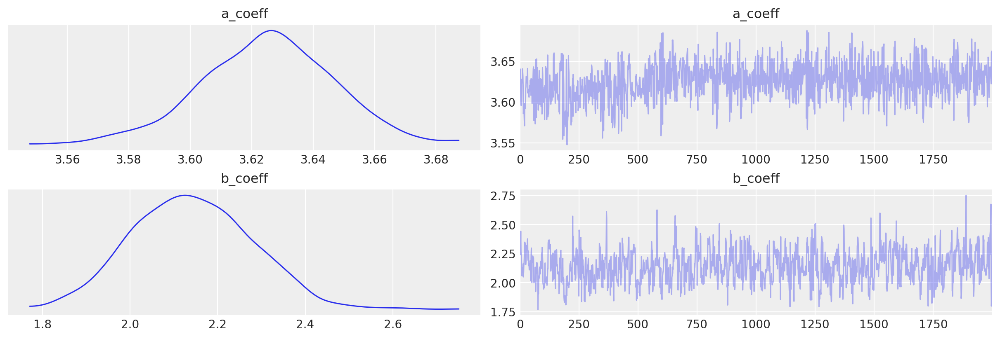

In [ ]:
# We obtain the model, the i_data and the posterior node positions and adjacency matrix and we save the i_data on the disk for future runs.

distance_model_mcmc_ex1, i_data_distance_model_mcmc_ex1, node_positions_posterior_distance_model_mcmc_ex1, adjacency_matrix_posterior_distance_model_mcmc_ex1 = distance_model_mcmc_approach(model_coordinates_ex1, graph_ex1, observed_adjacency_ex1, node_indices_0_ex1, node_indices_1_ex1)

os.makedirs(MAIN_FOLDER_PATH + '/Exercise-1', exist_ok=True)
az.to_netcdf(i_data_distance_model_mcmc_ex1, MAIN_FOLDER_PATH + '/Exercise-1/distance_model_mcmc_ex_1.nc')

Shape validation failed: input_shape: (1, 2000), minimum_shape: (chains=2, draws=4)


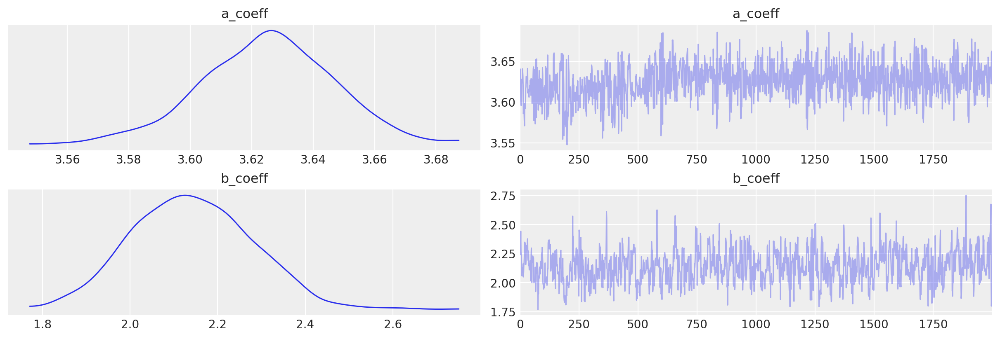

In [ ]:
# We directly take i_data from disk and use it to obtain the posterior latent 2D positions and the posterior adjacency matrix.

i_data_distance_model_mcmc_ex1 = az.from_netcdf(MAIN_FOLDER_PATH + '/Exercise-1/distance_model_mcmc_ex_1.nc')

node_positions_posterior_distance_model_mcmc_ex1, adjacency_matrix_posterior_distance_model_mcmc_ex1 = distance_model_mcmc_approach_loaded(graph_ex1, i_data_distance_model_mcmc_ex1)

In [ ]:
def plot_latent_representations_ex1(graph, node_positions_posterior):
  # This function plots the 2D latent representations of the graph points.
  # The edges have higher width if the number of messages between its nodes is large (for this, a linear interpolation has been used).

  plt.figure(figsize=(10, 10))
  node_colors = ['blue' if node_data['faction'] == 'A' else 'red' for _, node_data in graph.nodes(data=True)]

  MIN_EDGE_WIDTH = 1
  MAX_EDGE_WIDTH = 5
  edge_messages = np.array([edge_data['messages'] for _, _, edge_data in graph.edges(data=True)])

  for node_0, node_1, edge_data in graph.edges(data=True):
    X_coordinates = [node_positions_posterior[node_0, 0], node_positions_posterior[node_1, 0]]
    Y_coordinates = [node_positions_posterior[node_0, 1], node_positions_posterior[node_1, 1]]

    # Linear interpolation to draw the edges with higher widths if the number of messages between the nodes is large.
    edge_width = MIN_EDGE_WIDTH + ((edge_data['messages'] - edge_messages.min()) / (edge_messages.max() - edge_messages.min())) \
    * (MAX_EDGE_WIDTH - MIN_EDGE_WIDTH)

    plt.plot(X_coordinates, Y_coordinates, c='gray', linewidth=edge_width, zorder=1)

  plt.scatter(node_positions_posterior[:, 0], node_positions_posterior[:, 1], c=node_colors, zorder=2)
  plt.show()


def most_influential_politician_each_faction_ex1_0(graph, node_positions_posterior, adjacency_matrix_posterior):
  # Here we compute the most influential politician inside each faction.
  # We do this by finding for each node the sum of all the number of messages between the node itself and all other nodes from same faction.
  # For each faction, we keep the node with the greatest sum. (Basically these nodes have the highest interaction inside their faction).
  # For the number of messages, the posterior adjacency matrix has been used,
  # which has been calculated by using the parameters obtained from the probabilistic model.

  node_factions = [node_data['faction'] for _, node_data in graph.nodes(data=True)]

  node_influences_inside_faction = np.zeros(len(graph.nodes))
  for node_0 in range(len(graph.nodes)):
    for node_1 in range(node_0 + 1, len(graph.nodes)):
      if node_factions[node_0] == node_factions[node_1]:
        node_influences_inside_faction[node_0] += adjacency_matrix_posterior[node_0, node_1]
        node_influences_inside_faction[node_1] += adjacency_matrix_posterior[node_1, node_0]

  most_influential_inside_faction = dict()
  for node in range(len(graph.nodes)):
    if node_factions[node] not in most_influential_inside_faction:
      most_influential_inside_faction[node_factions[node]] = node
    elif node_influences_inside_faction[most_influential_inside_faction[node_factions[node]]] < node_influences_inside_faction[node]:
      most_influential_inside_faction[node_factions[node]] = node

  for faction, node in most_influential_inside_faction.items():
    print(f'Most Influential Politician (Inside Faction) from Faction {faction}: {graph.nodes[node]['name']} (Node {node})')

  # Here we plot the points with different sizes in the latent 2D space.
  # If a point has higher size, then it is more suitable to be the most influential in that faction.
  # The nodes colored with a darker colour are the solutions for each faction.
  MIN_POINT_SIZE = 10
  MAX_POINT_SIZE = 500

  plt.figure(figsize=(10, 10))
  plt.title('Most Influential Politician (Inside Faction) for Each Faction')
  node_colors = ['blue' if node_data['faction'] == 'A' else 'red' for _, node_data in graph.nodes(data=True)]
  node_sizes = MIN_POINT_SIZE + ((node_influences_inside_faction - node_influences_inside_faction.min()) / (node_influences_inside_faction.max() - node_influences_inside_faction.min())) \
  * (MAX_POINT_SIZE - MIN_POINT_SIZE)
  plt.scatter(node_positions_posterior[:, 0], node_positions_posterior[:, 1], c=node_colors, s=node_sizes)
  for faction, node in most_influential_inside_faction.items():
    if faction == 'A':
      most_influential_node_color = 'darkblue'
    else:
      most_influential_node_color = 'darkred'
    plt.scatter(node_positions_posterior[node, 0], node_positions_posterior[node, 1], c=most_influential_node_color, s=MAX_POINT_SIZE)
  plt.show()


def most_influential_politician_each_faction_ex1_1(graph, node_positions_posterior):
  # This function has the same goal with one from above, but instead of using the adjacency matrix, we directly use the latent 2D representations (different approach).
  # In order to compute the most influential politician in each faction, we can use just identify the node which is the closest to the centroid of that faction (computed as the mean of the
  # nodes from that faction). Each faction can be viewed as a cluster in that latent space.

  node_factions = [node_data['faction'] for _, node_data in graph.nodes(data=True)]

  faction_centroids = dict()
  num_members_per_faction = dict()
  for node in range(len(graph.nodes)):
    if node_factions[node] not in faction_centroids:
      faction_centroids[node_factions[node]] = node_positions_posterior[node]
    else:
      faction_centroids[node_factions[node]] += node_positions_posterior[node]

    if node_factions[node] not in num_members_per_faction:
      num_members_per_faction[node_factions[node]] = 1
    else:
      num_members_per_faction[node_factions[node]] += 1
  for faction in faction_centroids.keys():
    faction_centroids[faction] /= num_members_per_faction[faction]

  node_influences_inside_faction = np.zeros(len(graph.nodes))
  for node in range(len(graph.nodes)):
    # We compute distance from node to the centroid of the faction it belongs to and use the formula e^(-distance) in order to obtain the influence of that node in the faction (value in (0, 1]).
    # 1 if the node is exactly the centroid of the cluster.
    node_influences_inside_faction[node] = np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - faction_centroids[node_factions[node]])**2)))

  most_influential_inside_faction = dict()
  for node in range(len(graph.nodes)):
    if node_factions[node] not in most_influential_inside_faction:
      most_influential_inside_faction[node_factions[node]] = node
    elif node_influences_inside_faction[most_influential_inside_faction[node_factions[node]]] < node_influences_inside_faction[node]:
      most_influential_inside_faction[node_factions[node]] = node

  for faction, node in most_influential_inside_faction.items():
    print(f'Most Influential Politician (Inside Faction) from Faction {faction}: {graph.nodes[node]['name']} (Node {node})')

  # Here we plot the points with different sizes in the latent 2D space.
  # If a point has higher size, then it is more suitable to be the most influential in that faction.
  # The nodes colored with a darker colour are the solutions for each faction.
  MIN_POINT_SIZE = 10
  MAX_POINT_SIZE = 500

  plt.figure(figsize=(10, 10))
  plt.title('Most Influential Politician (Inside Faction) for Each Faction')
  node_colors = ['blue' if node_data['faction'] == 'A' else 'red' for _, node_data in graph.nodes(data=True)]
  node_sizes = MIN_POINT_SIZE + ((node_influences_inside_faction - node_influences_inside_faction.min()) / (node_influences_inside_faction.max() - node_influences_inside_faction.min())) \
  * (MAX_POINT_SIZE - MIN_POINT_SIZE)
  plt.scatter(node_positions_posterior[:, 0], node_positions_posterior[:, 1], c=node_colors, s=node_sizes)
  for faction, node in most_influential_inside_faction.items():
    if faction == 'A':
      most_influential_node_color = 'darkblue'
    else:
      most_influential_node_color = 'darkred'
    plt.scatter(node_positions_posterior[node, 0], node_positions_posterior[node, 1], c=most_influential_node_color, s=MAX_POINT_SIZE)
  plt.show()


def most_influential_politician_overall_ex1_0(graph, node_positions_posterior, adjacency_matrix_posterior):
  # Here we do a similar computation as in most_influential_politician_each_faction_ex1_0, but now for each node we take into consideration the sum of number of edges from that node
  # to any other node in the graph, regardless of their faction
  # (we can interpret this as politicians who have a lot of connections inside their faction but also inside the opposite faction,
  # so they can represent the interests of the faction while also being able to negotiate with the other faction).
  # We obtain a solution node for each faction (but during computation we take into account all nodes, as mentioned above).
  # We use the same posterior adjacency matrix computed from the parameters of the probabilistic model.

  node_factions = [node_data['faction'] for _, node_data in graph.nodes(data=True)]

  node_influences = adjacency_matrix_posterior.sum(axis=1)

  most_influential = dict()
  for node in range(len(graph.nodes)):
    if node_factions[node] not in most_influential:
      most_influential[node_factions[node]] = node
    elif node_influences[most_influential[node_factions[node]]] < node_influences[node]:
      most_influential[node_factions[node]] = node

  for faction, node in most_influential.items():
    print(f'Most Influential Politician (Overall) from Faction {faction}: {graph.nodes[node]['name']} (Node {node})')

  # Here we plot the points with different sizes in the latent 2D space.
  # If a point has higher size, then it is more suitable to be the solution from that faction.
  # The nodes colored with a darker colour are the solutions for each faction.
  MIN_POINT_SIZE = 10
  MAX_POINT_SIZE = 500

  plt.figure(figsize=(10, 10))
  plt.title('Most Influential Politician (Overall) from Each Faction')
  node_colors = ['blue' if node_data['faction'] == 'A' else 'red' for _, node_data in graph.nodes(data=True)]
  node_sizes = MIN_POINT_SIZE + ((node_influences - node_influences.min()) / (node_influences.max() - node_influences.min())) \
  * (MAX_POINT_SIZE - MIN_POINT_SIZE)
  plt.scatter(node_positions_posterior[:, 0], node_positions_posterior[:, 1], c=node_colors, s=node_sizes)
  for faction, node in most_influential.items():
    if faction == 'A':
      most_influential_node_color = 'darkblue'
    else:
      most_influential_node_color = 'darkred'
    plt.scatter(node_positions_posterior[node, 0], node_positions_posterior[node, 1], c=most_influential_node_color, s=MAX_POINT_SIZE)
  plt.show()


def most_influential_politician_overall_ex1_1(graph, node_positions_posterior):
  # This is a second approach to finding the most influential politician overall. Instead of using a posterior adjacency matrix, we can look directly at the latent 2D positions.
  # The most influential politician should be the node closest to the centroid of all nodes from the graph (regardless of their faction).
  # We will compute such a most influential node from each faction (they will negociate on behalf of their respective faction).

  node_factions = [node_data['faction'] for _, node_data in graph.nodes(data=True)]

  centroid = np.mean(node_positions_posterior, axis=0)

  node_influences = np.zeros(len(graph.nodes))
  for node in range(len(graph.nodes)):
    # We compute e^(-distance).
    # 1 for very influential point.
    node_influences[node] = np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - centroid)**2)))

  most_influential = dict()
  for node in range(len(graph.nodes)):
    if node_factions[node] not in most_influential:
      most_influential[node_factions[node]] = node
    elif node_influences[most_influential[node_factions[node]]] < node_influences[node]:
      most_influential[node_factions[node]] = node

  for faction, node in most_influential.items():
    print(f'Most Influential Politician (Overall) from Faction {faction}: {graph.nodes[node]['name']} (Node {node})')

  # Here we plot the points with different sizes in the latent 2D space.
  # If a point has higher size, then it is more suitable to be the solution from that faction.
  # The nodes colored with a darker colour are the solutions for each faction.
  MIN_POINT_SIZE = 10
  MAX_POINT_SIZE = 500

  plt.figure(figsize=(10, 10))
  plt.title('Most Influential Politician (Overall) from Each Faction')
  node_colors = ['blue' if node_data['faction'] == 'A' else 'red' for _, node_data in graph.nodes(data=True)]
  node_sizes = MIN_POINT_SIZE + ((node_influences - node_influences.min()) / (node_influences.max() - node_influences.min())) \
  * (MAX_POINT_SIZE - MIN_POINT_SIZE)
  plt.scatter(node_positions_posterior[:, 0], node_positions_posterior[:, 1], c=node_colors, s=node_sizes)
  for faction, node in most_influential.items():
    if faction == 'A':
      most_influential_node_color = 'darkblue'
    else:
      most_influential_node_color = 'darkred'
    plt.scatter(node_positions_posterior[node, 0], node_positions_posterior[node, 1], c=most_influential_node_color, s=MAX_POINT_SIZE)
  plt.show()


def ex1_0(graph, node_positions_posterior, adjacency_matrix_posterior):
  plot_latent_representations_ex1(graph, node_positions_posterior)
  most_influential_politician_each_faction_ex1_0(graph, node_positions_posterior, adjacency_matrix_posterior)
  most_influential_politician_overall_ex1_0(graph, node_positions_posterior, adjacency_matrix_posterior)


def ex1_1(graph, node_positions_posterior):
  plot_latent_representations_ex1(graph, node_positions_posterior)
  most_influential_politician_each_faction_ex1_1(graph, node_positions_posterior)
  most_influential_politician_overall_ex1_1(graph, node_positions_posterior)

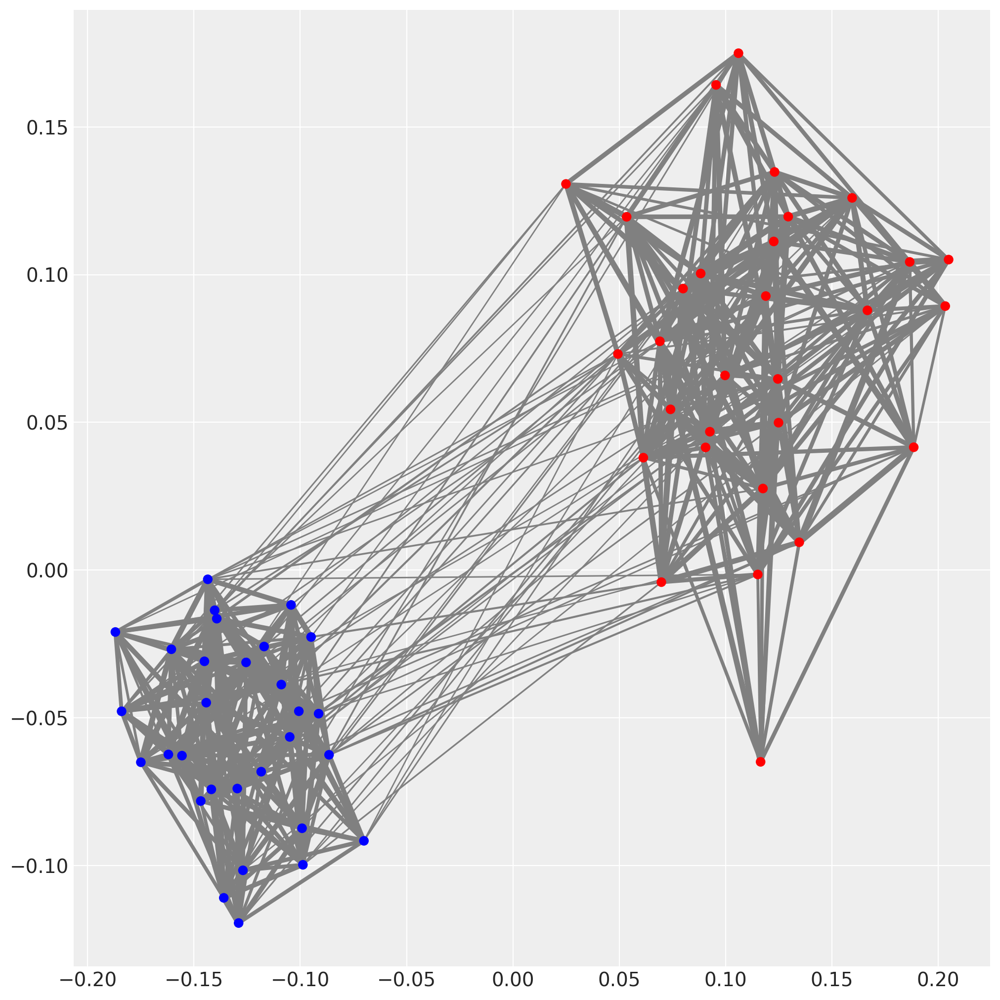

Most Influential Politician (Inside Faction) from Faction A: Eric Hill (Node 0)
Most Influential Politician (Inside Faction) from Faction B: Heather Mcdonald (Node 30)


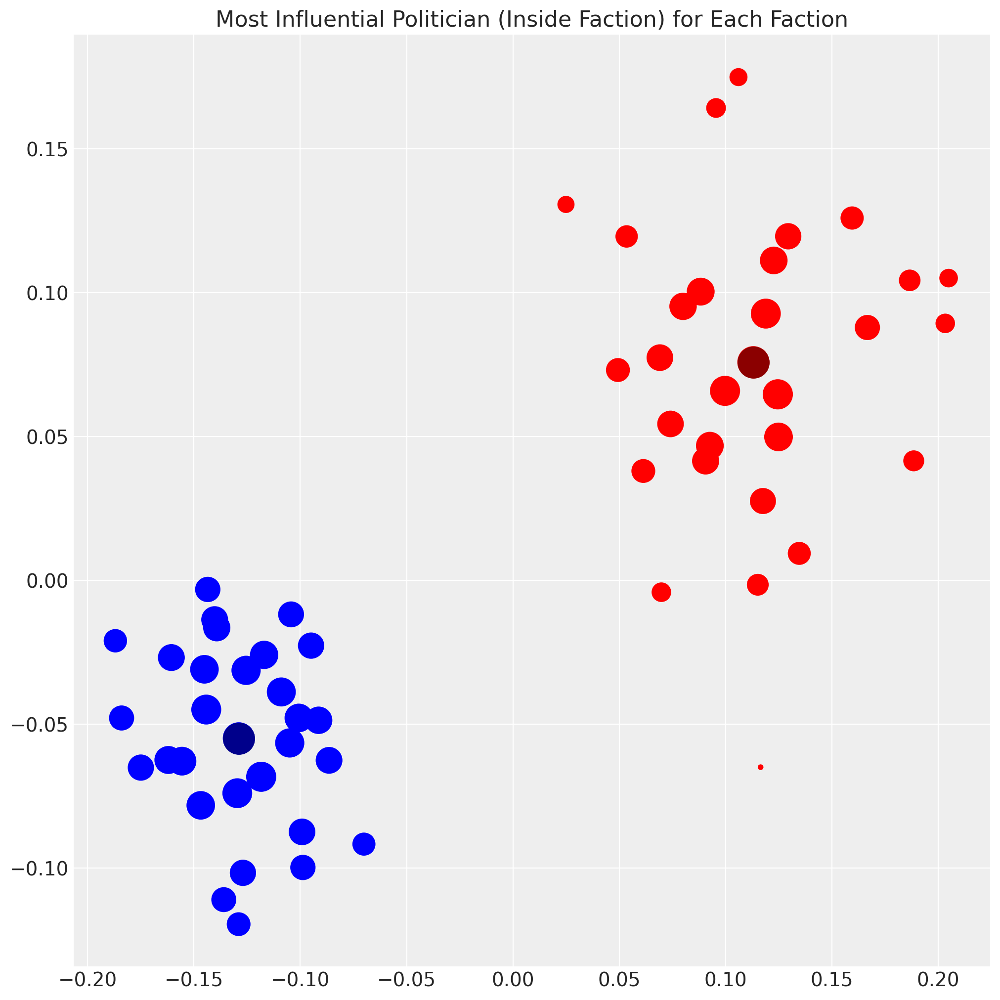

Most Influential Politician (Overall) from Faction A: Cynthia Adams (Node 29)
Most Influential Politician (Overall) from Faction B: Michael Merritt (Node 50)


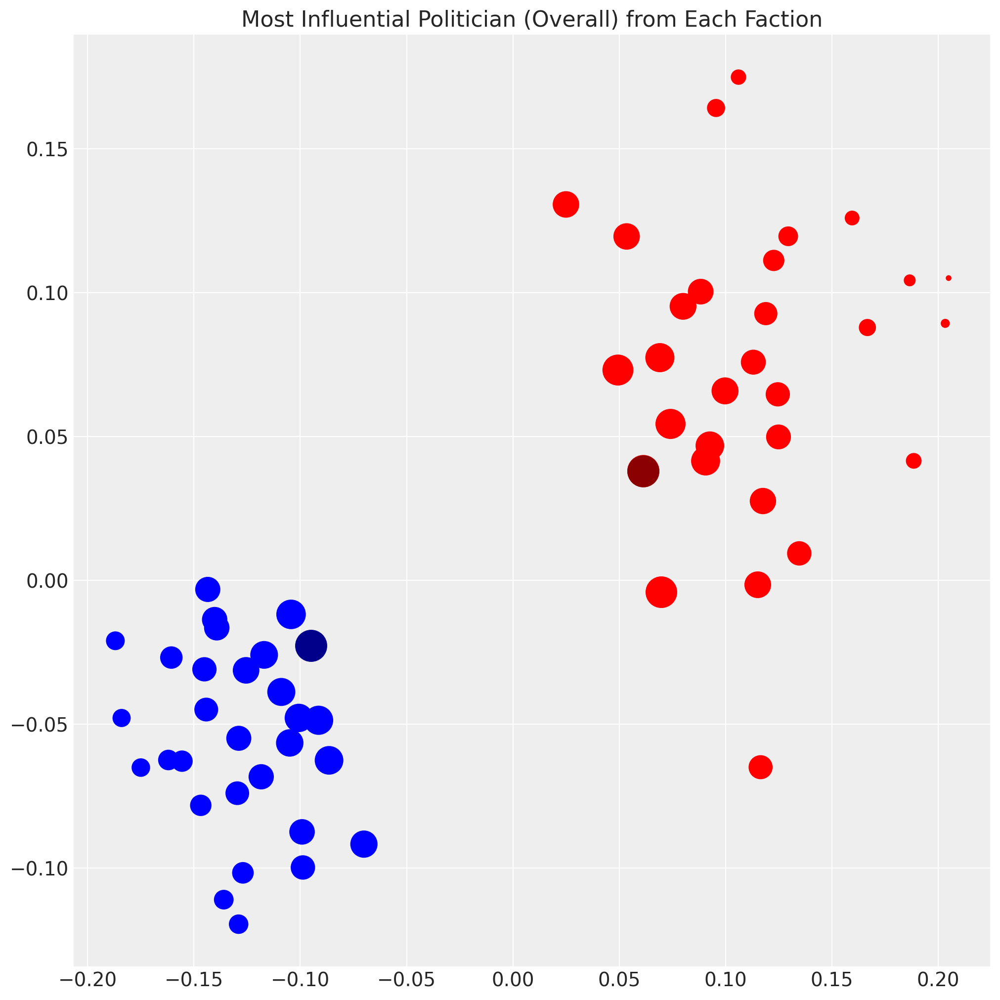

In [ ]:
# We have two approaches to answering the questions of Exercise 1.

# ex1_0(graph_ex1, node_positions_posterior_distance_model_mcmc_ex1, adjacency_matrix_posterior_distance_model_mcmc_ex1)
ex1_1(graph_ex1, node_positions_posterior_distance_model_mcmc_ex1)

## Answers Exercise 1:

For answering these two questions, we used the second approach (minimal distances to clusters' centroids).

Q1: Who is the most influential politician from each faction?
<br>
Answer:
<br>
Most Influential Politician (Inside Faction) from Faction A: Eric Hill (Node 0)
<br>
Most Influential Politician (Inside Faction) from Faction B: Heather Mcdonald (Node 30)

Q2: Who are the two politicians that are best suited for inter-faction negotiations?
<br>
Answer:
<br>
Most Influential Politician (Overall) from Faction A: Cynthia Adams (Node 29)
<br>
Most Influential Politician (Overall) from Faction B: Michael Merritt (Node 50)

### What happens if the 2 factions are completely separated?

&emsp; To answer this question, we will rebuild the same graph from Exercise 1, but we will delete the edges from nodes belonging to different factions.
<br>
&emsp; Afterwards, we run the same model inference and visualizing plots as in Exercise 1.

In [ ]:
# Here we rebuild the same graph from exercise 1.

graph_separated_ex1 = graph_ex1.copy()

edges_to_remove = []
for node_0, node_1, edge_data in graph_separated_ex1.edges(data=True):
  if graph_separated_ex1.nodes[node_0].get('faction') != graph_separated_ex1.nodes[node_1].get('faction'):
    edges_to_remove.append((node_0, node_1))

for node_0, node_1 in edges_to_remove:
    graph_separated_ex1.remove_edge(node_0, node_1)

Graph Visualization

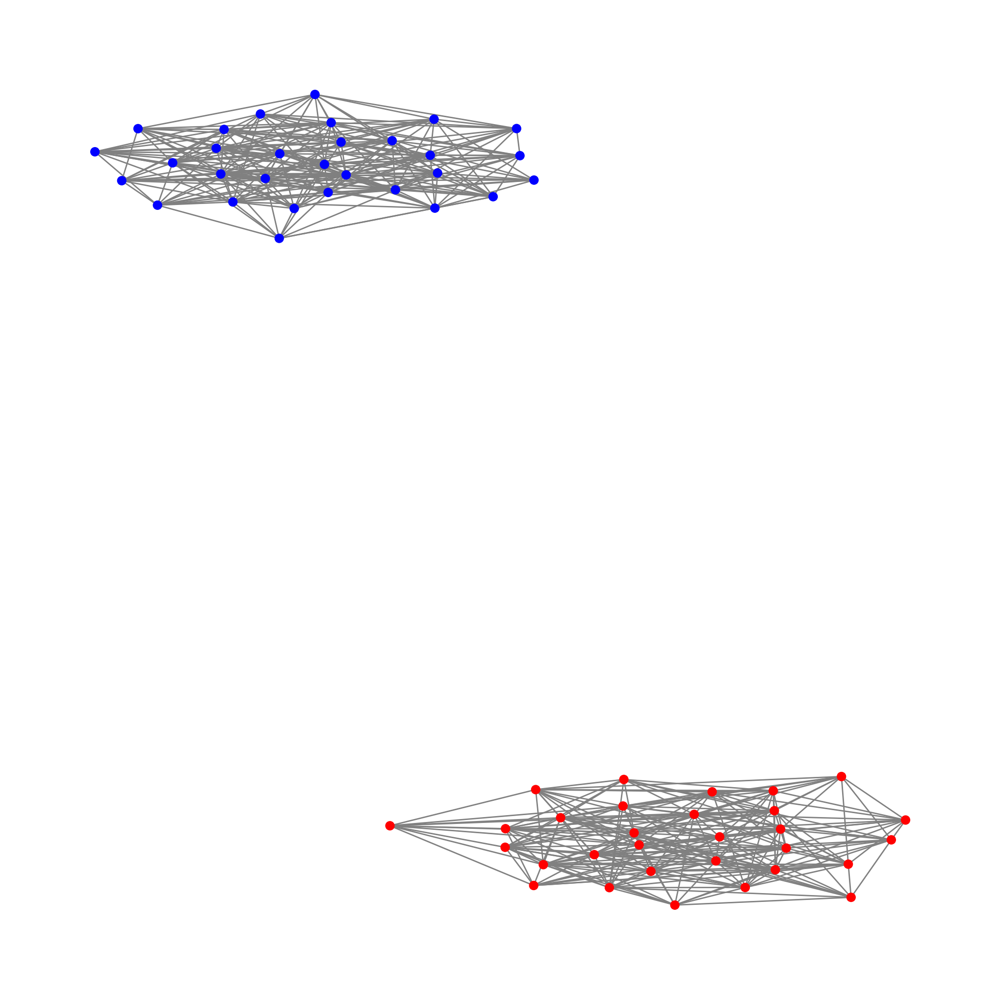

In [ ]:
plt.figure(figsize=(10, 10))
positions = nx.spring_layout(graph_separated_ex1, seed=23)
# blue for faction A, red for B
node_colors = ['blue' if node_data['faction'] == 'A' else 'red' for _, node_data in graph_separated_ex1.nodes(data=True)]
nx.draw(graph_separated_ex1, pos=positions, node_color=node_colors, edge_color='gray', node_size=35)
plt.show()

In [ ]:
# Here we build the adjacency matrix of the graph. Since the graph is undirected, we add the messages parameter for both mat[i, j] and mat[j, i].
# The matrix is therefore symmetrical.

adjacency_matrix_separated_ex1 = np.zeros((len(graph_separated_ex1.nodes), len(graph_separated_ex1.nodes)))
for node_0, node_1, edge_data in graph_separated_ex1.edges(data=True):
    adjacency_matrix_separated_ex1[node_0, node_1] += edge_data['messages']
    adjacency_matrix_separated_ex1[node_1, node_0] += edge_data['messages']

print('Adjacency Matrix:')
print(adjacency_matrix_separated_ex1)

Adjacency Matrix:
[[ 0. 21. 37. ...  0.  0.  0.]
 [21.  0. 21. ...  0.  0.  0.]
 [37. 21.  0. ...  0.  0.  0.]
 ...
 [ 0.  0.  0. ...  0.  0.  0.]
 [ 0.  0.  0. ...  0.  0. 26.]
 [ 0.  0.  0. ...  0. 26.  0.]]


In [ ]:
# Here we obtain all the ordered pairs (A, B) of nodes from the graph.
# k = 1 for np.triu_indices, which means we exclude the diagonal (in our cases, pairs of form (A, A)).

node_indices_0_separated_ex1, node_indices_1_separated_ex1 = np.triu_indices(len(graph_separated_ex1.nodes), k=1)
observed_adjacency_separated_ex1 = adjacency_matrix_separated_ex1[node_indices_0_separated_ex1, node_indices_1_separated_ex1]

model_coordinates_separated_ex1 = {
    'nodes': list(graph_separated_ex1.nodes),
    'node_dims': ['x', 'y'],
    'edges': np.arange(len(observed_adjacency_separated_ex1))
}

Output()

Shape validation failed: input_shape: (1, 2000), minimum_shape: (chains=2, draws=4)


'/content/drive/MyDrive/Project-Probabilistic-Programming-PP/Exercise-1/distance_model_mcmc_separated_ex_1.nc'

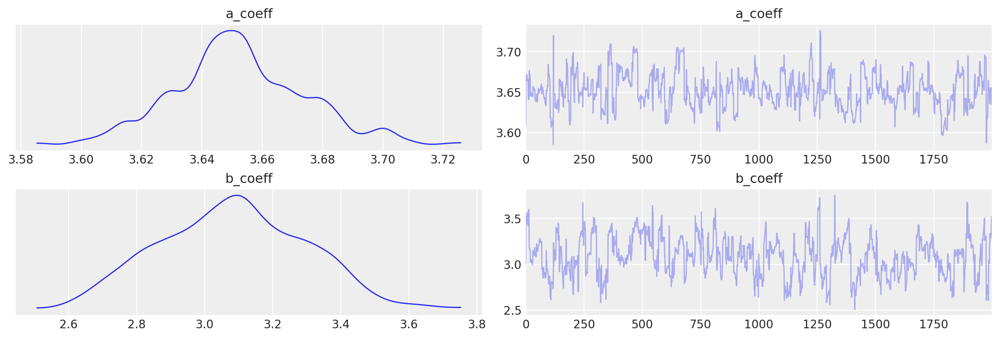

In [ ]:
# We obtain the model, the i_data and the posterior node positions and adjacency matrix and we save the i_data on the disk for future runs.

distance_model_mcmc_separated_ex1, i_data_distance_model_mcmc_separated_ex1, node_positions_posterior_distance_model_mcmc_separated_ex1, adjacency_matrix_posterior_distance_model_mcmc_separated_ex1 = distance_model_mcmc_approach(model_coordinates_separated_ex1, graph_separated_ex1, observed_adjacency_separated_ex1, node_indices_0_separated_ex1, node_indices_1_separated_ex1)

os.makedirs(MAIN_FOLDER_PATH + '/Exercise-1', exist_ok=True)
az.to_netcdf(i_data_distance_model_mcmc_separated_ex1, MAIN_FOLDER_PATH + '/Exercise-1/distance_model_mcmc_separated_ex_1.nc')

Shape validation failed: input_shape: (1, 2000), minimum_shape: (chains=2, draws=4)


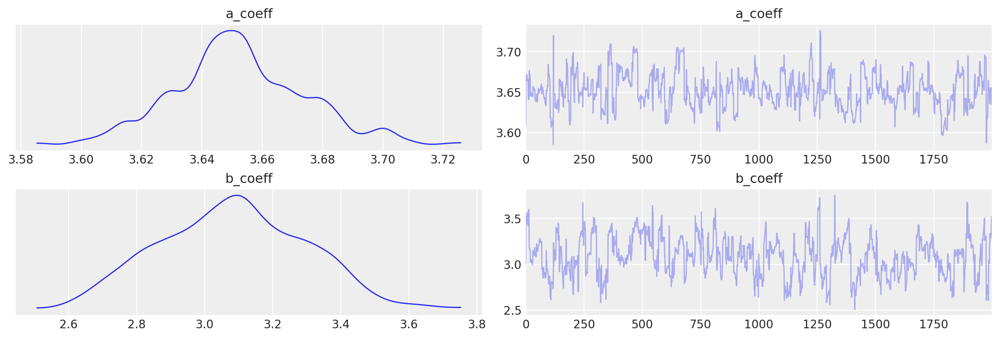

In [ ]:
# We directly take i_data from disk and use it to obtain the posterior latent 2D positions and the posterior adjacency matrix.

i_data_distance_model_mcmc_separated_ex1 = az.from_netcdf(MAIN_FOLDER_PATH + '/Exercise-1/distance_model_mcmc_separated_ex_1.nc')

node_positions_posterior_distance_model_mcmc_separated_ex1, adjacency_matrix_posterior_distance_model_mcmc_separated_ex1 = distance_model_mcmc_approach_loaded(graph_separated_ex1, i_data_distance_model_mcmc_separated_ex1)

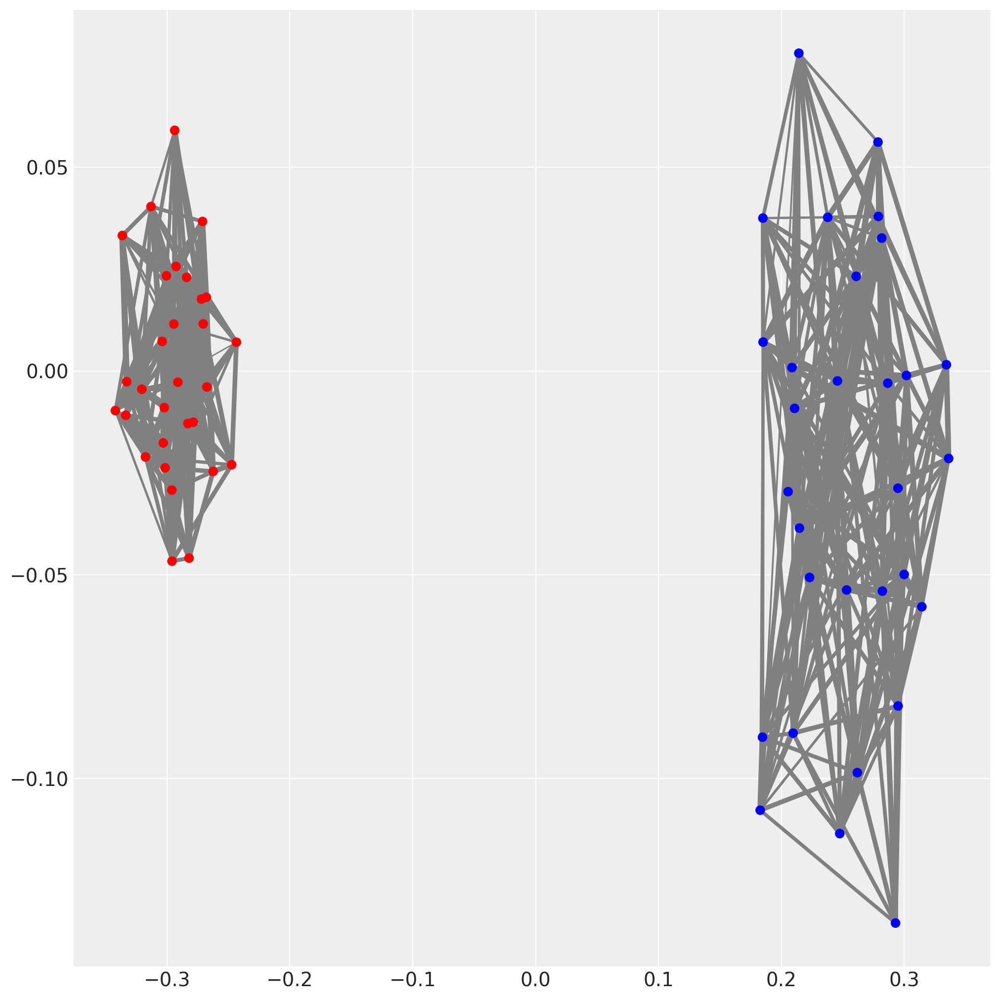

Most Influential Politician (Inside Faction) from Faction A: Eric Hill (Node 0)
Most Influential Politician (Inside Faction) from Faction B: Heather Mcdonald (Node 30)


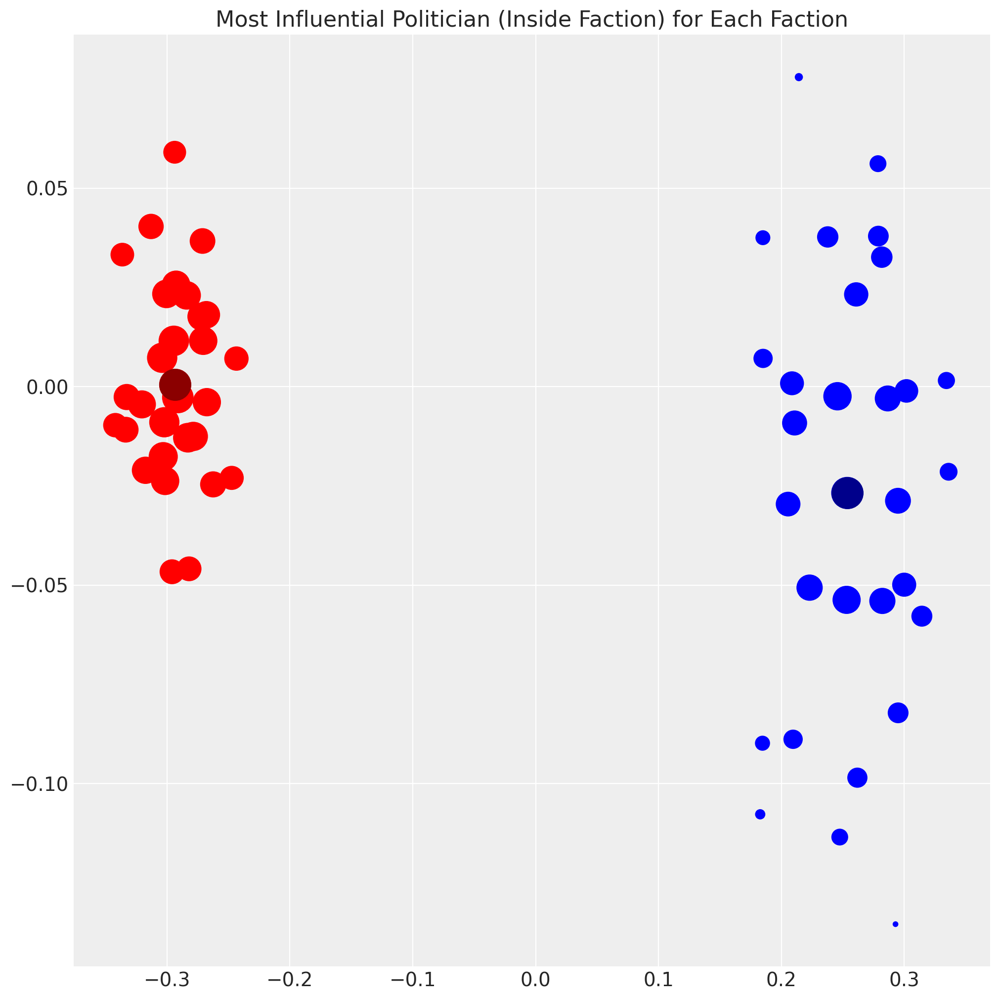

Most Influential Politician (Overall) from Faction A: Sydney Evans (Node 19)
Most Influential Politician (Overall) from Faction B: Zachary Richardson (Node 57)


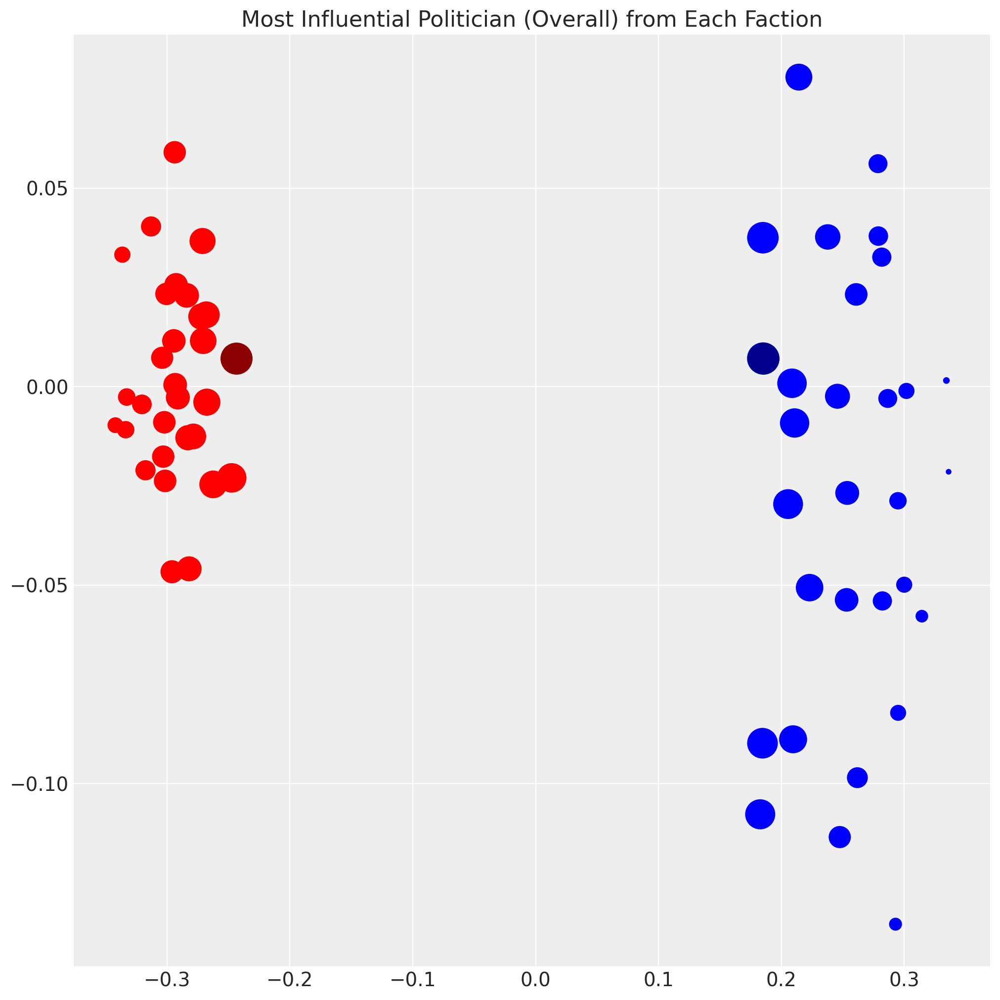

In [ ]:
# We have two approaches, as in Exercise 1.

# ex1_0(graph_separated_ex1, node_positions_posterior_distance_model_mcmc_separated_ex1, adjacency_matrix_posterior_distance_model_mcmc_separated_ex1)
ex1_1(graph_separated_ex1, node_positions_posterior_distance_model_mcmc_separated_ex1)

### What happens if the 2 factions are completely separated?

Answer:
<br>
&emsp; In the latent 2D space, the politicians seem to have clustered more compactly.
<br>
&emsp; Furthermore, the representation seems to be more orthogonal (the clusters are aligned on the X-axis, while each cluster has the principal component along the Y-axis).

For first question, if the two factions are completely separated, the most influential politician remains the same inside each faction (because the edges between nodes of same faction remained unchanged).
<br>
Q1: Who is the most influential politician from each faction?
<br>
Answer:
<br>
Most Influential Politician (Inside Faction) from Faction A: Eric Hill (Node 0)
<br>
Most Influential Politician (Inside Faction) from Faction B: Heather Mcdonald (Node 30)

For second question, the answers change if the factions are completely separated (now, there are actually no good negociators between factions, because no politician ever exchanged messages with another from opposite faction).
<br>
Q2: Who are the two politicians that are best suited for inter-faction negotiations?
<br>
Answer:
<br>
Most Influential Politician (Overall) from Faction A: Sydney Evans (Node 19)
<br>
Most Influential Politician (Overall) from Faction B: Zachary Richardson (Node 57)

## Exercise 2

Read Graph Data

In [ ]:
graph_ex2 = pickle.load(open(MAIN_FOLDER_PATH + '/ex_2_graph.pickle', 'rb'))

Graph Visualization

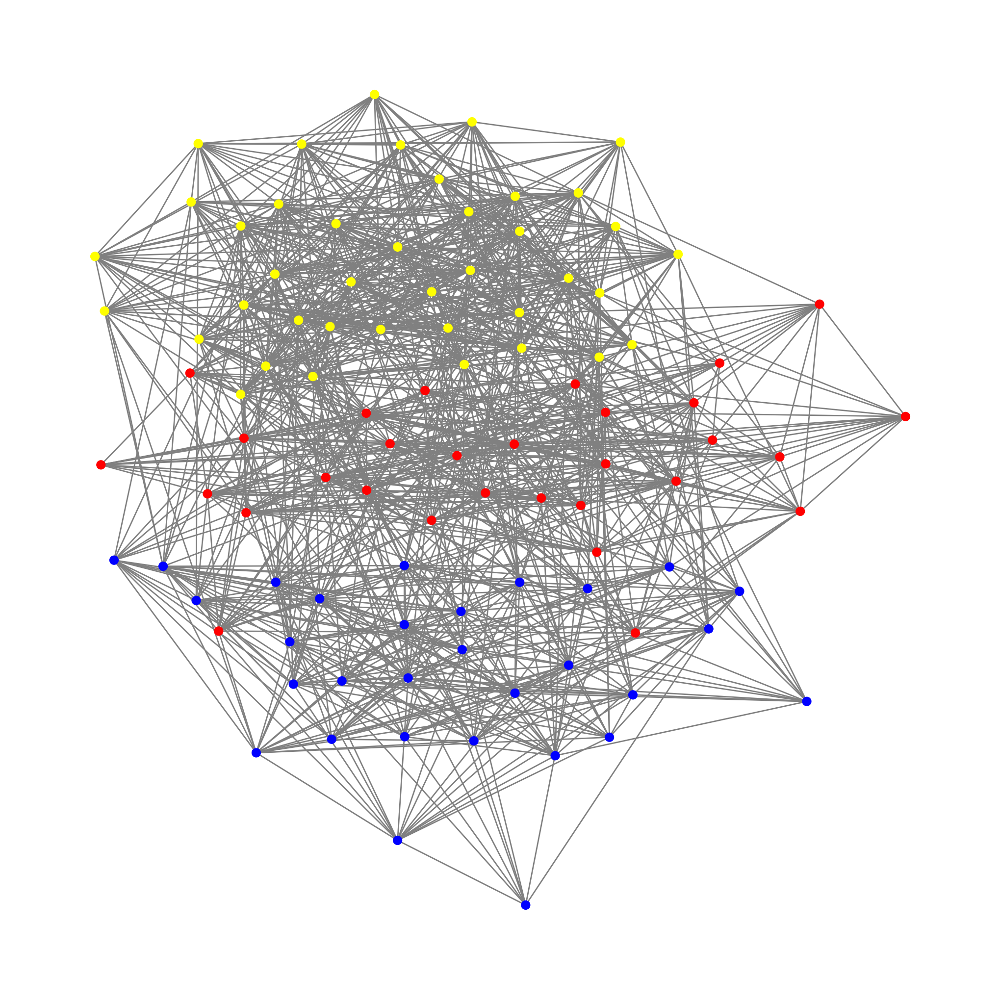

In [ ]:
plt.figure(figsize=(10, 10))
positions = nx.spring_layout(graph_ex2, seed=23)
# red for Caesar, blue for Pompey and yellow for Crassus
node_colors = ['red' if node_data['faction'] == 'Caesar' else 'blue' if node_data['faction'] == 'Pompey' else 'yellow' for _, node_data in graph_ex2.nodes(data=True)]
nx.draw(graph_ex2, pos=positions, node_color=node_colors, edge_color='gray', node_size=35)
plt.show()

In [ ]:
# Here we build the adjacency matrix of the graph. Since the graph is undirected, we add the meetings parameter for both mat[i, j] and mat[j, i].
# The matrix is therefore symmetrical.

adjacency_matrix_ex2 = np.zeros((len(graph_ex2.nodes), len(graph_ex2.nodes)))
for node_0, node_1, edge_data in graph_ex2.edges(data=True):
    adjacency_matrix_ex2[node_0, node_1] += edge_data['meetings']
    adjacency_matrix_ex2[node_1, node_0] += edge_data['meetings']

print('Adjacency Matrix:')
print(adjacency_matrix_ex2)

Adjacency Matrix:
[[ 0. 30. 28. ...  0.  0.  0.]
 [30.  0. 31. ...  0.  0.  0.]
 [28. 31.  0. ...  0.  0.  1.]
 ...
 [ 0.  0.  0. ...  0. 33.  0.]
 [ 0.  0.  0. ... 33.  0.  0.]
 [ 0.  0.  1. ...  0.  0.  0.]]


In [ ]:
# Here we obtain all the ordered pairs (A, B) of nodes from the graph.
# k = 1 for np.triu_indices, which means we exclude the diagonal (in our cases, pairs of form (A, A)).

node_indices_0_ex2, node_indices_1_ex2 = np.triu_indices(len(graph_ex2.nodes), k=1)
observed_adjacency_ex2 = adjacency_matrix_ex2[node_indices_0_ex2, node_indices_1_ex2]

model_coordinates_ex2 = {
    'nodes': list(graph_ex2.nodes),
    'node_dims': ['x', 'y'],
    'edges': np.arange(len(observed_adjacency_ex2))
}

Output()

Shape validation failed: input_shape: (1, 2000), minimum_shape: (chains=2, draws=4)


'/content/drive/MyDrive/Project-Probabilistic-Programming-PP/Exercise-2/distance_model_mcmc_ex_2.nc'

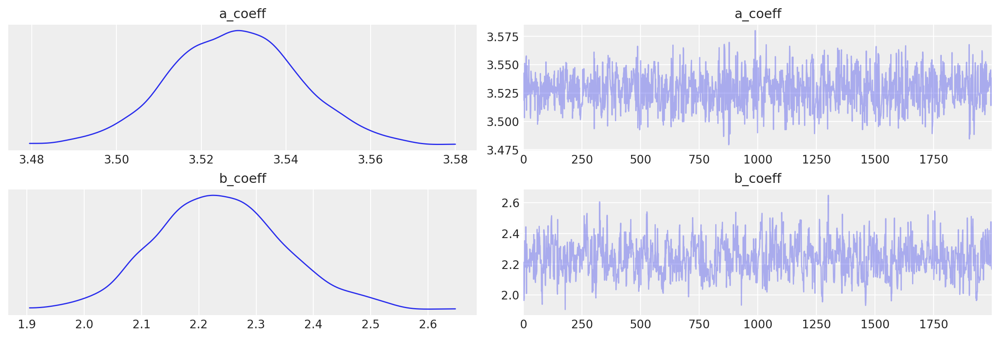

In [ ]:
# Here we call the same function that generated the latent 2D positions from Exercise 1, but now with the new graph and new adjacency matrix.

distance_model_mcmc_ex2, i_data_distance_model_mcmc_ex2, node_positions_posterior_distance_model_mcmc_ex2, adjacency_matrix_posterior_distance_model_mcmc_ex2 = distance_model_mcmc_approach(model_coordinates_ex2, graph_ex2, observed_adjacency_ex2, node_indices_0_ex2, node_indices_1_ex2)

# We save the i_data for future use.
os.makedirs(MAIN_FOLDER_PATH + '/Exercise-2', exist_ok=True)
az.to_netcdf(i_data_distance_model_mcmc_ex2, MAIN_FOLDER_PATH + '/Exercise-2/distance_model_mcmc_ex_2.nc')

Shape validation failed: input_shape: (1, 2000), minimum_shape: (chains=2, draws=4)


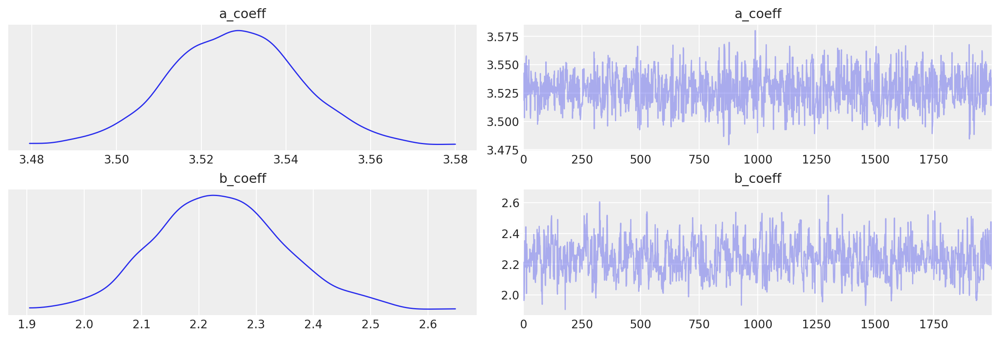

In [ ]:
# We directly take i_data from disk and use it to obtain the posterior latent 2D positions and the posterior adjacency matrix.

i_data_distance_model_mcmc_ex2 = az.from_netcdf(MAIN_FOLDER_PATH + '/Exercise-2/distance_model_mcmc_ex_2.nc')

node_positions_posterior_distance_model_mcmc_ex2, adjacency_matrix_posterior_distance_model_mcmc_ex2 = distance_model_mcmc_approach_loaded(graph_ex2, i_data_distance_model_mcmc_ex2)

In [ ]:
def plot_latent_representations_ex2(graph, node_positions_posterior):
  # This function plots the 2D latent representations of the graph nodes.
  # red is Caesar, blue is Pompey, yellow is Crassus
  # We also plot the edges with varying widths depending on the number of meetings between those two nodes (we use linear interpolation).

  plt.figure(figsize=(10, 10))
  node_colors = ['red' if node_data['faction'] == 'Caesar' else 'blue' if node_data['faction'] == 'Pompey' else 'yellow' for _, node_data in graph.nodes(data=True)]

  MIN_EDGE_WIDTH = 1
  MAX_EDGE_WIDTH = 5
  edge_meetings = np.array([edge_data['meetings'] for _, _, edge_data in graph.edges(data=True)])

  for node_0, node_1, edge_data in graph.edges(data=True):
    X_coordinates = [node_positions_posterior[node_0, 0], node_positions_posterior[node_1, 0]]
    Y_coordinates = [node_positions_posterior[node_0, 1], node_positions_posterior[node_1, 1]]

    # Linear interpolation for edge_width.
    edge_width = MIN_EDGE_WIDTH + ((edge_data['meetings'] - edge_meetings.min()) / (edge_meetings.max() - edge_meetings.min())) \
    * (MAX_EDGE_WIDTH - MIN_EDGE_WIDTH)

    plt.plot(X_coordinates, Y_coordinates, c='gray', linewidth=edge_width, zorder=1)

  plt.scatter(node_positions_posterior[:, 0], node_positions_posterior[:, 1], c=node_colors, zorder=2)
  plt.show()

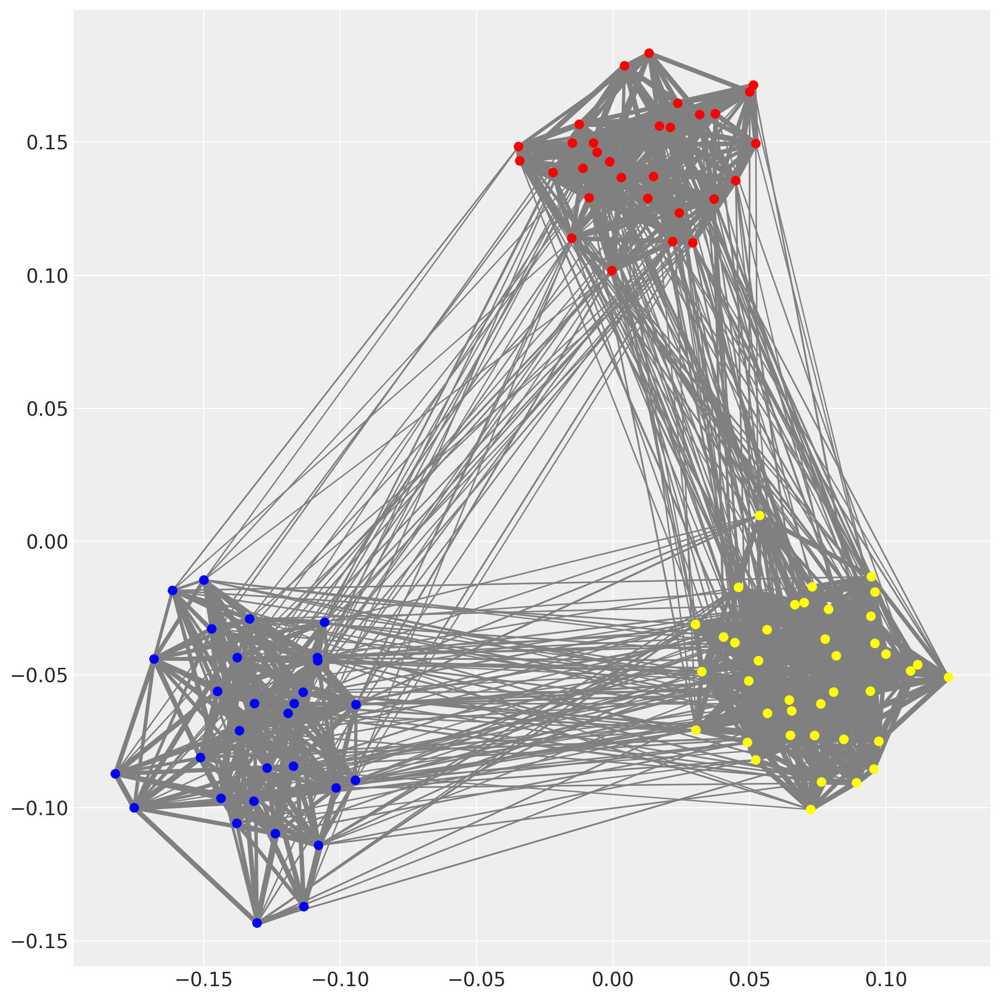

In [ ]:
# We can see that the nodes generated very clear clusters, while also the edges inside a cluster have higher widths than those between clusters.

plot_latent_representations_ex2(graph_ex2, node_positions_posterior_distance_model_mcmc_ex2)

In [ ]:
nodes_caesar_ex2 = [node for node, node_data in graph_ex2.nodes(data=True) if node_data['faction'] == 'Caesar']
nodes_pompey_ex2 = [node for node, node_data in graph_ex2.nodes(data=True) if node_data['faction'] == 'Pompey']
nodes_crassus_ex2 = [node for node, node_data in graph_ex2.nodes(data=True) if node_data['faction'] == 'Crassus']

print('Nodes of Faction Caesar:')
print(nodes_caesar_ex2)

print('Nodes of Faction Pompey:')
print(nodes_pompey_ex2)

print('Nodes of Faction Crassus:')
print(nodes_crassus_ex2)

Nodes of Faction Caesar:
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29]
Nodes of Faction Pompey:
[30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59]
Nodes of Faction Crassus:
[60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99]


In [ ]:
faction_migrations_ex2_file = pd.read_csv(MAIN_FOLDER_PATH + '/ex_2_assignments.csv')

nodes_migrating_to_caesar_ex2 = []
nodes_migrating_to_pompey_ex2 = []

for index, row in faction_migrations_ex2_file.iterrows():
  if row['new_faction'] == 'Caesar':
    nodes_migrating_to_caesar_ex2.append(row['node_id'])
  else:
    nodes_migrating_to_pompey_ex2.append(row['node_id'])

print('Nodes Migrating to Caesar:')
print(nodes_migrating_to_caesar_ex2)

print('Nodes Migrating to Pompey:')
print(nodes_migrating_to_pompey_ex2)

Nodes Migrating to Caesar:
[72, 92, 68, 84, 67, 83, 99, 65, 96, 97]
Nodes Migrating to Pompey:
[94, 70, 69, 74, 60, 86, 91, 76, 95, 87]


In [ ]:
# Here we compute the nodes from the Crassus Faction for which we have to find to what faction they will migrate to.

remaining_nodes_crassus_ex2 = []

for node, node_data in graph_ex2.nodes(data=True):
  if node_data['faction'] == 'Crassus' and node not in nodes_migrating_to_caesar_ex2 and node not in nodes_migrating_to_pompey_ex2:
    remaining_nodes_crassus_ex2.append(node)

print('Remaining Nodes of Faction Crassus:')
print(remaining_nodes_crassus_ex2)

Remaining Nodes of Faction Crassus:
[61, 62, 63, 64, 66, 71, 73, 75, 77, 78, 79, 80, 81, 82, 85, 88, 89, 90, 93, 98]


### Exercise 2:
<br>
<br>
&emsp; We can use the same approach from first exercise in order to obtain 2D latent representations for the nodes in the new graph.
<br>
<br>
&emsp; Afterwards, we need for the Crassus Faction's members to compute how they will migrate to one of the other 2 factions (Caesar or Pompey).
<br>
<br>
&emsp; Since the outcome is binary (or Caesar, or Pompey), we can think of a sigmoid function that will output the probability of joining one of the faction. The sigmoid function gives real number outputs in range $[0, 1]$.
<br>
<br>
&emsp; Any value greater than 0.5 we can consider it as joining Pompey's faction, while a value lower than 0.5 will mean joining Caesar's faction.
<br>
<br>
&emsp; For the input to the sigmoid function we need a mathematical combination that takes into account that node's distances to nodes from Caesar's faction and to nodes from Pompey's faction (this distances are inverse proportional to the number of meetings). Smaller distances to members of Caesar's faction should mean that the probability of joining Caesar's faction would increase. The same will apply in the case of Pompey's faction.

### Below are three tried approaches:
<br>
<br>
1.
<br>
$$\text{sigmoid(a_coeff + b_coeff_caesar}\times\text{distances_to_caesar + b_coeff_pompey}\times\text{distances_to_pompey)}$$
<br>
<br>
&emsp; Basically a linear combination between the sum of distances from the current node to all nodes belonging to Caesar's faction and the sum of distances from the current node to all nodes belonging to Pompey's faction.
<br>
<br>
2.
<br>
&emsp; Same liniar combination from first approach, but now the sum of distances for both Caesar's faction and Pompey's faction is computed as a sum of exponentials base $e$, where the exponent is the negative distance.
<br>
<br>
&emsp; Practically, if the Euclidian distance is large, then $e^\text{-distance}$ becomes small (signaling that the respective node is far away and should not be taken into consideration when computing how much total influence that specific faction has in the migration decision). If distance is small, then $e^\text{-distance}$ becomes large and this mean that we have a node very near the migrating one (therefore, influencing it greatly).
<br>
<br>
3.
<br>
&emsp; A quadratic combination using the same distances from second approach.
<br>
<br>
&emsp; This approach was tried, because if we look at how the nodes from the .csv file migrate to either Caesar or Pompey, we can see that we can't draw a linear boundary between the nodes migrating to Caesar and the ones migrating to Pompey (at least we can't in the current 2D latent space). The plots before help visualize this potential problem. Therefore, a more complex formula should be used, one that includes more non-liniarities (besides the already used sigmoid function) and is able to store more information through the use of more parameters learned during model inference.
<br>
<br>
<br>
<br>
<br>
&emsp; For all three approaches from above, we run the inference only on the nodes from the Crassus faction for which we know where they will migrate to (since we will use that information as observed data for a Bernoulli, which will have as probability the output from the sigmoid).
<br>
<br>
&emsp; All parameters during all three approaches have been samples from a Gaussian Distribution with mean 0 and standard deviation 2.

In [ ]:
def faction_migration_model_mcmc_approach_0(node_positions_posterior, nodes_caesar, nodes_pompey, nodes_migrating_to_caesar, nodes_migrating_to_pompey):
  # First approach, sum of Euclidian distances for both factions (all nodes from Caesar and all nodes from Pompey).

  migrating_nodes = np.array(nodes_migrating_to_caesar + nodes_migrating_to_pompey)
  observed_migrating_nodes = np.array(([0] * len(nodes_migrating_to_caesar)) + ([1] * len(nodes_migrating_to_pompey)))

  distances_to_caesar = []
  for node in migrating_nodes:
    current_distance_to_caesar = 0.0
    for node_caesar in nodes_caesar:
      current_distance_to_caesar += np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_caesar])**2))
    distances_to_caesar.append(current_distance_to_caesar)
  distances_to_caesar = np.array(distances_to_caesar)

  distances_to_pompey = []
  for node in migrating_nodes:
    current_distance_to_pompey = 0.0
    for node_pompey in nodes_pompey:
      current_distance_to_pompey += np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_pompey])**2))
    distances_to_pompey.append(current_distance_to_pompey)
  distances_to_pompey = np.array(distances_to_pompey)

  with pm.Model() as model:
    a_coeff = pm.Normal('a_coeff', mu=0.0, sigma=2.0)
    b_coeff_caesar = pm.Normal('b_coeff_caesar', mu=0.0, sigma=2.0)
    b_coeff_pompey = pm.Normal('b_coeff_pompey', mu=0.0, sigma=2.0)

    # The linear combination, which becomes input for the sigmoid.
    linear_combination = a_coeff + b_coeff_caesar * distances_to_caesar + b_coeff_pompey * distances_to_pompey
    faction_migrating_probability = pm.math.sigmoid(linear_combination)

    # Sigmoid outputs real values in [0, 1], which we use for a Bernoulli Distribution, which will output to what faction the nodes will migrate to.
    # The observed data are the nodes from the .csv file for which we know where they migrate to.
    pm.Bernoulli('observed_migrating_nodes', p=faction_migrating_probability, observed=observed_migrating_nodes)

    i_data = pm.sample(draws=2000, tune=500, chains=2, target_accept=0.9, random_seed=23)

  az.plot_trace(i_data, var_names=['a_coeff', 'b_coeff_caesar', 'b_coeff_pompey'])
  az.summary(i_data, var_names=['a_coeff', 'b_coeff_caesar', 'b_coeff_pompey'])

  return model, i_data


def faction_migration_model_mcmc_approach_1(node_positions_posterior, nodes_caesar, nodes_pompey, nodes_migrating_to_caesar, nodes_migrating_to_pompey):
  # Second approach, sum of exponentials base e, with the negative Euclidian distance as exponent.
  # The probabilistic model remains the same.

  migrating_nodes = np.array(nodes_migrating_to_caesar + nodes_migrating_to_pompey)
  observed_migrating_nodes = np.array(([0] * len(nodes_migrating_to_caesar)) + ([1] * len(nodes_migrating_to_pompey)))

  distances_to_caesar = []
  for node in migrating_nodes:
    current_distance_to_caesar = 0.0
    for node_caesar in nodes_caesar:
      current_distance_to_caesar += np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_caesar])**2)))
    distances_to_caesar.append(current_distance_to_caesar)
  distances_to_caesar = np.array(distances_to_caesar)

  distances_to_pompey = []
  for node in migrating_nodes:
    current_distance_to_pompey = 0.0
    for node_pompey in nodes_pompey:
      current_distance_to_pompey += np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_pompey])**2)))
    distances_to_pompey.append(current_distance_to_pompey)
  distances_to_pompey = np.array(distances_to_pompey)

  with pm.Model() as model:
    a_coeff = pm.Normal('a_coeff', mu=0.0, sigma=2.0)
    b_coeff_caesar = pm.Normal('b_coeff_caesar', mu=0.0, sigma=2.0)
    b_coeff_pompey = pm.Normal('b_coeff_pompey', mu=0.0, sigma=2.0)

    linear_combination = a_coeff + b_coeff_caesar * distances_to_caesar + b_coeff_pompey * distances_to_pompey
    faction_migrating_probability = pm.math.sigmoid(linear_combination)

    pm.Bernoulli('observed_migrating_nodes', p=faction_migrating_probability, observed=observed_migrating_nodes)

    i_data = pm.sample(draws=2000, tune=500, chains=2, target_accept=0.9, random_seed=23)

  az.plot_trace(i_data, var_names=['a_coeff', 'b_coeff_caesar', 'b_coeff_pompey'])
  az.summary(i_data, var_names=['a_coeff', 'b_coeff_caesar', 'b_coeff_pompey'])

  return model, i_data


def faction_migration_model_mcmc_approach_2(node_positions_posterior, nodes_caesar, nodes_pompey, nodes_migrating_to_caesar, nodes_migrating_to_pompey):
  # Third approach, same distances as in the second approach, but we have a quadratic combination now.

  migrating_nodes = np.array(nodes_migrating_to_caesar + nodes_migrating_to_pompey)
  observed_migrating_nodes = np.array(([0] * len(nodes_migrating_to_caesar)) + ([1] * len(nodes_migrating_to_pompey)))

  distances_to_caesar = []
  for node in migrating_nodes:
    current_distance_to_caesar = 0.0
    for node_caesar in nodes_caesar:
      current_distance_to_caesar += np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_caesar])**2)))
    distances_to_caesar.append(current_distance_to_caesar)
  distances_to_caesar = np.array(distances_to_caesar)

  distances_to_pompey = []
  for node in migrating_nodes:
    current_distance_to_pompey = 0.0
    for node_pompey in nodes_pompey:
      current_distance_to_pompey += np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_pompey])**2)))
    distances_to_pompey.append(current_distance_to_pompey)
  distances_to_pompey = np.array(distances_to_pompey)

  with pm.Model() as model:
    a_coeff = pm.Normal('a_coeff', mu=0.0, sigma=2.0)
    b_coeff_caesar = pm.Normal('b_coeff_caesar', mu=0.0, sigma=2.0)
    b_coeff_pompey = pm.Normal('b_coeff_pompey', mu=0.0, sigma=2.0)
    c_coeff_caesar = pm.Normal('c_coeff_caesar', mu=0.0, sigma=2.0)
    c_coeff_pompey = pm.Normal('c_coeff_pompey', mu=0.0, sigma=2.0)

    # We use a quadratic combination as input for the sigmoid function.
    quadratic_combination = a_coeff + b_coeff_caesar * distances_to_caesar + b_coeff_pompey * distances_to_pompey \
      + c_coeff_caesar * (distances_to_caesar**2) + c_coeff_pompey * (distances_to_pompey**2)
    faction_migrating_probability = pm.math.sigmoid(quadratic_combination)

    pm.Bernoulli('observed_migrating_nodes', p=faction_migrating_probability, observed=observed_migrating_nodes)

    i_data = pm.sample(draws=2000, tune=500, chains=2, target_accept=0.9, random_seed=23)

  az.plot_trace(i_data, var_names=['a_coeff', 'b_coeff_caesar', 'b_coeff_pompey', 'c_coeff_caesar', 'c_coeff_pompey'])
  az.summary(i_data, var_names=['a_coeff', 'b_coeff_caesar', 'b_coeff_pompey', 'c_coeff_caesar', 'c_coeff_pompey'])

  return model, i_data

In [ ]:
def plot_faction_migrations_ex2(graph, node_positions_posterior, nodes_migrating_to_caesar, nodes_migrating_to_pompey):
  # This function plots the 2D latent positions of the nodes and in the case of the Crassus faction we color them depending on
  # to what other faction they will migrate to. (If we don't know, we color them as black).

  plt.figure(figsize=(10, 10))
  node_colors = []
  for node, node_data in graph.nodes(data=True):
    if node_data['faction'] == 'Caesar': # nodes from Caesar's faction
      node_colors.append('darkred')
    elif node_data['faction'] == 'Pompey': # nodes from Pompey's faction
      node_colors.append('darkblue')
    elif node in nodes_migrating_to_caesar: # nodes migrating to Caesar
      node_colors.append('red')
    elif node in nodes_migrating_to_pompey: # nodes migrating to Pompey
      node_colors.append('blue')
    else: # nodes for which we do not know any information (they are from Crassus faction)
      node_colors.append('black')

  MIN_EDGE_WIDTH = 1
  MAX_EDGE_WIDTH = 5
  edge_meetings = np.array([edge_data['meetings'] for _, _, edge_data in graph.edges(data=True)])

  for node_0, node_1, edge_data in graph.edges(data=True):
    X_coordinates = [node_positions_posterior[node_0, 0], node_positions_posterior[node_1, 0]]
    Y_coordinates = [node_positions_posterior[node_0, 1], node_positions_posterior[node_1, 1]]

    # Linear interpolation for the width of the edge, depending on the number of meetings between the two nodes.
    edge_width = MIN_EDGE_WIDTH + ((edge_data['meetings'] - edge_meetings.min()) / (edge_meetings.max() - edge_meetings.min())) \
    * (MAX_EDGE_WIDTH - MIN_EDGE_WIDTH)

    plt.plot(X_coordinates, Y_coordinates, c='gray', linewidth=edge_width, zorder=1)

  plt.scatter(node_positions_posterior[:, 0], node_positions_posterior[:, 1], c=node_colors, zorder=2)
  plt.show()


def ex2_0(graph, node_positions_posterior, i_data, csv_nodes_migrating_to_caesar, csv_nodes_migrating_to_pompey):
  # This function should received the i_data obtained from the first approach method of model inference.
  # Obtain fixed values for the parameters by taking the mean of their distributions.
  a_coeff_posterior = i_data.posterior['a_coeff'].mean().values
  b_coeff_caesar_posterior = i_data.posterior['b_coeff_caesar'].mean().values
  b_coeff_pompey_posterior = i_data.posterior['b_coeff_pompey'].mean().values

  nodes_caesar = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Caesar']
  nodes_pompey = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Pompey']
  nodes_crassus = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Crassus']

  # Compute same distances as in first approach during model inference.
  distances_to_caesar = []
  for node in nodes_crassus:
    current_distance_to_caesar = 0.0
    for node_caesar in nodes_caesar:
      current_distance_to_caesar += np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_caesar])**2))
    distances_to_caesar.append(current_distance_to_caesar)
  distances_to_caesar = np.array(distances_to_caesar)

  distances_to_pompey = []
  for node in nodes_crassus:
    current_distance_to_pompey = 0.0
    for node_pompey in nodes_pompey:
      current_distance_to_pompey += np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_pompey])**2))
    distances_to_pompey.append(current_distance_to_pompey)
  distances_to_pompey = np.array(distances_to_pompey)

  linear_combination = a_coeff_posterior + b_coeff_caesar_posterior * distances_to_caesar + b_coeff_pompey_posterior * distances_to_pompey
  faction_migrating_probability = 1.0 / (1.0 + np.exp(-linear_combination)) # Sigmoid function.

  nodes_migrating_to_caesar = []
  nodes_migrating_to_pompey = []

  # We obtain the faction to which each node migrates to, along with a confidence score.
  for node, probability in zip(nodes_crassus, faction_migrating_probability):
    if node in csv_nodes_migrating_to_caesar:
      continue
    if node in csv_nodes_migrating_to_pompey:
      continue
    if probability < 0.5:
      nodes_migrating_to_caesar.append((node, probability))
    else:
      nodes_migrating_to_pompey.append((node, probability))

  # We plot the migrations.
  plot_faction_migrations_ex2(graph, node_positions_posterior,
   [node for node, _ in nodes_migrating_to_caesar] + csv_nodes_migrating_to_caesar,
    [node for node, _ in nodes_migrating_to_pompey] + csv_nodes_migrating_to_pompey)

  print('Number of Nodes Migrating to Caesar:')
  print(len(nodes_migrating_to_caesar))

  print('Number of Nodes Migrating to Pompey:')
  print(len(nodes_migrating_to_pompey))

  # Sort the nodes from Crassus faction by their confidence score and output a top of undecided politicians.
  TOP_K_UNDECIDED_NODES = 5

  nodes_migrating_to_caesar_sorted = sorted(nodes_migrating_to_caesar, key=lambda x: x[1], reverse=True)
  nodes_migrating_to_pompey_sorted = sorted(nodes_migrating_to_pompey, key=lambda x: x[1], reverse=False)

  print(f'Top {TOP_K_UNDECIDED_NODES} Nodes Most Undecided but Migrated to Caesar:')
  for node, probability in nodes_migrating_to_caesar_sorted[:TOP_K_UNDECIDED_NODES]:
    print(f'Node {node} (Migrated with Probability: {1.0 - probability})')

  print(f'Top {TOP_K_UNDECIDED_NODES} Nodes Most Undecided but Migrated to Pompey:')
  for node, probability in nodes_migrating_to_pompey_sorted[:TOP_K_UNDECIDED_NODES]:
    print(f'Node {node} (Migrated with Probability: {probability})')

  all_csv_nodes = csv_nodes_migrating_to_caesar + csv_nodes_migrating_to_pompey
  csv_nodes_predicted_to_caesar = []
  csv_nodes_predicted_to_pompey = []
  for node, probability in zip(nodes_crassus, faction_migrating_probability):
    if node not in all_csv_nodes:
      continue
    if probability < 0.5:
      csv_nodes_predicted_to_caesar.append((node, probability))
    else:
      csv_nodes_predicted_to_pompey.append((node, probability))

  return [node for node, _ in nodes_migrating_to_caesar], [node for node, _ in nodes_migrating_to_pompey], \
          [node for node, _ in csv_nodes_predicted_to_caesar], [node for node, _ in csv_nodes_predicted_to_pompey]


def ex2_1(graph, node_positions_posterior, i_data, csv_nodes_migrating_to_caesar, csv_nodes_migrating_to_pompey):
  # This function does the same logic as the previous one, but the i_data it receives should belong to a second approach model inference.

  a_coeff_posterior = i_data.posterior['a_coeff'].mean().values
  b_coeff_caesar_posterior = i_data.posterior['b_coeff_caesar'].mean().values
  b_coeff_pompey_posterior = i_data.posterior['b_coeff_pompey'].mean().values

  nodes_caesar = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Caesar']
  nodes_pompey = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Pompey']
  nodes_crassus = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Crassus']

  # Computes the distances in the same way as during the second approach model inference.
  distances_to_caesar = []
  for node in nodes_crassus:
    current_distance_to_caesar = 0.0
    for node_caesar in nodes_caesar:
      current_distance_to_caesar += np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_caesar])**2)))
    distances_to_caesar.append(current_distance_to_caesar)
  distances_to_caesar = np.array(distances_to_caesar)

  distances_to_pompey = []
  for node in nodes_crassus:
    current_distance_to_pompey = 0.0
    for node_pompey in nodes_pompey:
      current_distance_to_pompey += np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_pompey])**2)))
    distances_to_pompey.append(current_distance_to_pompey)
  distances_to_pompey = np.array(distances_to_pompey)

  linear_combination = a_coeff_posterior + b_coeff_caesar_posterior * distances_to_caesar + b_coeff_pompey_posterior * distances_to_pompey
  faction_migrating_probability = 1.0 / (1.0 + np.exp(-linear_combination))

  nodes_migrating_to_caesar = []
  nodes_migrating_to_pompey = []

  for node, probability in zip(nodes_crassus, faction_migrating_probability):
    if node in csv_nodes_migrating_to_caesar:
      continue
    if node in csv_nodes_migrating_to_pompey:
      continue
    if probability < 0.5:
      nodes_migrating_to_caesar.append((node, probability))
    else:
      nodes_migrating_to_pompey.append((node, probability))

  plot_faction_migrations_ex2(graph, node_positions_posterior,
   [node for node, _ in nodes_migrating_to_caesar] + csv_nodes_migrating_to_caesar,
    [node for node, _ in nodes_migrating_to_pompey] + csv_nodes_migrating_to_pompey)

  print('Number of Nodes Migrating to Caesar:')
  print(len(nodes_migrating_to_caesar))

  print('Number of Nodes Migrating to Pompey:')
  print(len(nodes_migrating_to_pompey))

  TOP_K_UNDECIDED_NODES = 5

  nodes_migrating_to_caesar_sorted = sorted(nodes_migrating_to_caesar, key=lambda x: x[1], reverse=True)
  nodes_migrating_to_pompey_sorted = sorted(nodes_migrating_to_pompey, key=lambda x: x[1], reverse=False)

  print(f'Top {TOP_K_UNDECIDED_NODES} Nodes Most Undecided but Migrated to Caesar:')
  for node, probability in nodes_migrating_to_caesar_sorted[:TOP_K_UNDECIDED_NODES]:
    print(f'Node {node} (Migrated with Probability: {1.0 - probability})')

  print(f'Top {TOP_K_UNDECIDED_NODES} Nodes Most Undecided but Migrated to Pompey:')
  for node, probability in nodes_migrating_to_pompey_sorted[:TOP_K_UNDECIDED_NODES]:
    print(f'Node {node} (Migrated with Probability: {probability})')

  all_csv_nodes = csv_nodes_migrating_to_caesar + csv_nodes_migrating_to_pompey
  csv_nodes_predicted_to_caesar = []
  csv_nodes_predicted_to_pompey = []
  for node, probability in zip(nodes_crassus, faction_migrating_probability):
    if node not in all_csv_nodes:
      continue
    if probability < 0.5:
      csv_nodes_predicted_to_caesar.append((node, probability))
    else:
      csv_nodes_predicted_to_pompey.append((node, probability))

  return [node for node, _ in nodes_migrating_to_caesar], [node for node, _ in nodes_migrating_to_pompey], \
          [node for node, _ in csv_nodes_predicted_to_caesar], [node for node, _ in csv_nodes_predicted_to_pompey]


def ex2_2(graph, node_positions_posterior, i_data, csv_nodes_migrating_to_caesar, csv_nodes_migrating_to_pompey):
  # This function does the same logic as the previous two functions, but it receives an i_data resulted from a third approach model inference.
  a_coeff_posterior = i_data.posterior['a_coeff'].mean().values
  b_coeff_caesar_posterior = i_data.posterior['b_coeff_caesar'].mean().values
  b_coeff_pompey_posterior = i_data.posterior['b_coeff_pompey'].mean().values
  c_coeff_caesar_posterior = i_data.posterior['c_coeff_caesar'].mean().values
  c_coeff_pompey_posterior = i_data.posterior['c_coeff_pompey'].mean().values

  nodes_caesar = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Caesar']
  nodes_pompey = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Pompey']
  nodes_crassus = [node for node, node_data in graph.nodes(data=True) if node_data['faction'] == 'Crassus']

  # Computes the distances as in the third approach model inference.
  distances_to_caesar = []
  for node in nodes_crassus:
    current_distance_to_caesar = 0.0
    for node_caesar in nodes_caesar:
      current_distance_to_caesar += np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_caesar])**2)))
    distances_to_caesar.append(current_distance_to_caesar)
  distances_to_caesar = np.array(distances_to_caesar)

  distances_to_pompey = []
  for node in nodes_crassus:
    current_distance_to_pompey = 0.0
    for node_pompey in nodes_pompey:
      current_distance_to_pompey += np.exp(-np.sqrt(np.sum((node_positions_posterior[node] - node_positions_posterior[node_pompey])**2)))
    distances_to_pompey.append(current_distance_to_pompey)
  distances_to_pompey = np.array(distances_to_pompey)

  quadratic_combination = a_coeff_posterior + b_coeff_caesar_posterior * distances_to_caesar + b_coeff_pompey_posterior * distances_to_pompey \
    + c_coeff_caesar_posterior * (distances_to_caesar**2) + c_coeff_pompey_posterior * (distances_to_pompey**2)
  faction_migrating_probability = 1.0 / (1.0 + np.exp(-quadratic_combination))

  nodes_migrating_to_caesar = []
  nodes_migrating_to_pompey = []

  for node, probability in zip(nodes_crassus, faction_migrating_probability):
    if node in csv_nodes_migrating_to_caesar:
      continue
    if node in csv_nodes_migrating_to_pompey:
      continue
    if probability < 0.5:
      nodes_migrating_to_caesar.append((node, probability))
    else:
      nodes_migrating_to_pompey.append((node, probability))

  plot_faction_migrations_ex2(graph, node_positions_posterior,
   [node for node, _ in nodes_migrating_to_caesar] + csv_nodes_migrating_to_caesar,
    [node for node, _ in nodes_migrating_to_pompey] + csv_nodes_migrating_to_pompey)

  print('Number of Nodes Migrating to Caesar:')
  print(len(nodes_migrating_to_caesar))

  print('Number of Nodes Migrating to Pompey:')
  print(len(nodes_migrating_to_pompey))

  TOP_K_UNDECIDED_NODES = 5

  nodes_migrating_to_caesar_sorted = sorted(nodes_migrating_to_caesar, key=lambda x: x[1], reverse=True)
  nodes_migrating_to_pompey_sorted = sorted(nodes_migrating_to_pompey, key=lambda x: x[1], reverse=False)

  print(f'Top {TOP_K_UNDECIDED_NODES} Nodes Most Undecided but Migrated to Caesar:')
  for node, probability in nodes_migrating_to_caesar_sorted[:TOP_K_UNDECIDED_NODES]:
    print(f'Node {node} (Migrated with Probability: {1.0 - probability})')

  print(f'Top {TOP_K_UNDECIDED_NODES} Nodes Most Undecided but Migrated to Pompey:')
  for node, probability in nodes_migrating_to_pompey_sorted[:TOP_K_UNDECIDED_NODES]:
    print(f'Node {node} (Migrated with Probability: {probability})')

  all_csv_nodes = csv_nodes_migrating_to_caesar + csv_nodes_migrating_to_pompey
  csv_nodes_predicted_to_caesar = []
  csv_nodes_predicted_to_pompey = []
  for node, probability in zip(nodes_crassus, faction_migrating_probability):
    if node not in all_csv_nodes:
      continue
    if probability < 0.5:
      csv_nodes_predicted_to_caesar.append((node, probability))
    else:
      csv_nodes_predicted_to_pompey.append((node, probability))

  return [node for node, _ in nodes_migrating_to_caesar], [node for node, _ in nodes_migrating_to_pompey], \
          [node for node, _ in csv_nodes_predicted_to_caesar], [node for node, _ in csv_nodes_predicted_to_pompey]

### First Approach Model Inference for Exercise 2
<br>
<br>
&emsp; We will plot the initial latent 2D representations of the graph. For the Crassus nodes we will color only the nodes for which we know where they migrate to (based on the .csv file).
<br>
&emsp; We obtain the solutions and we plot how the nodes will migrate to the other two factions.

Output()

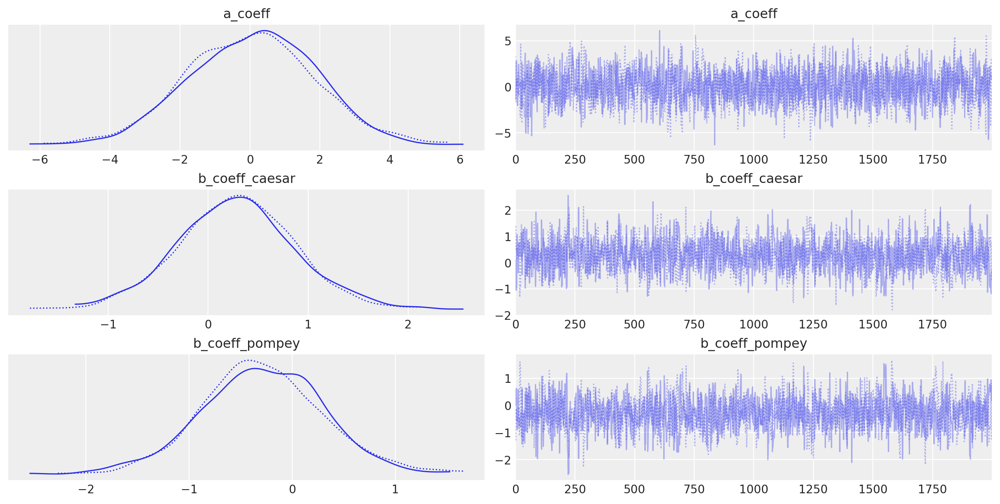

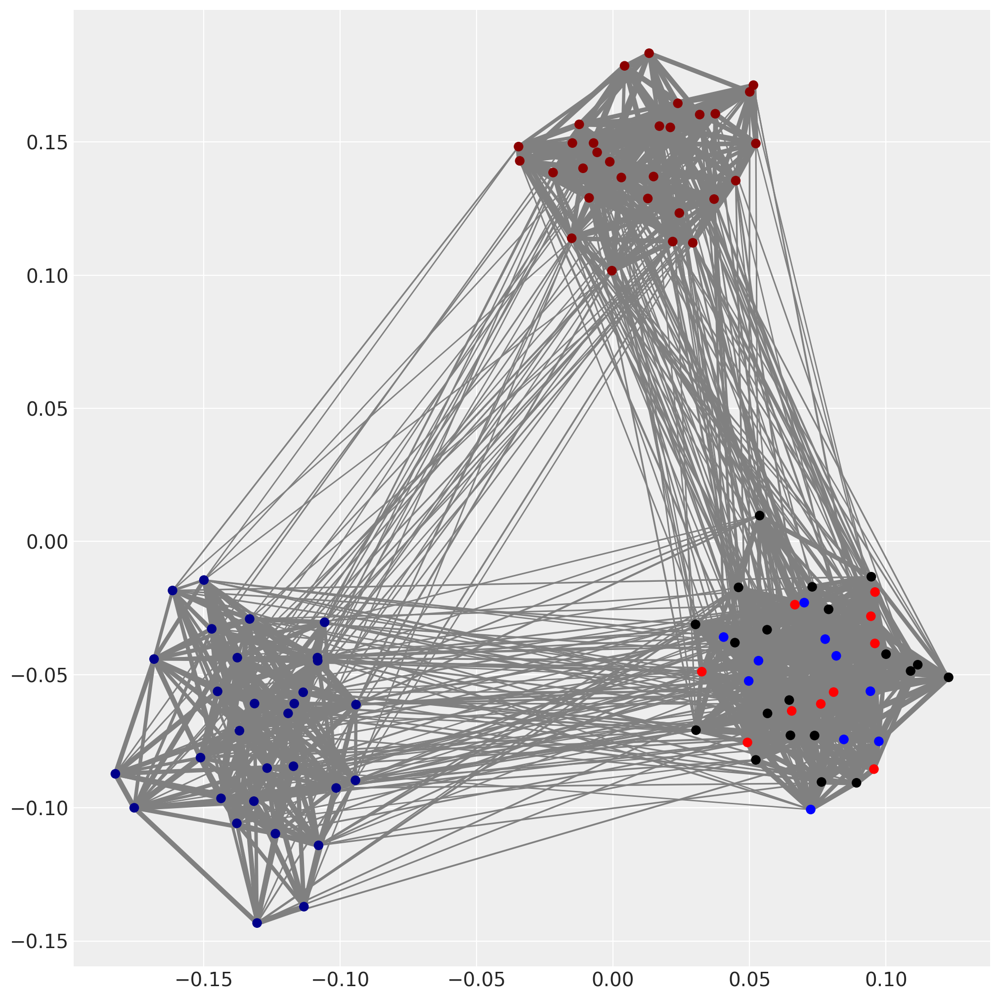

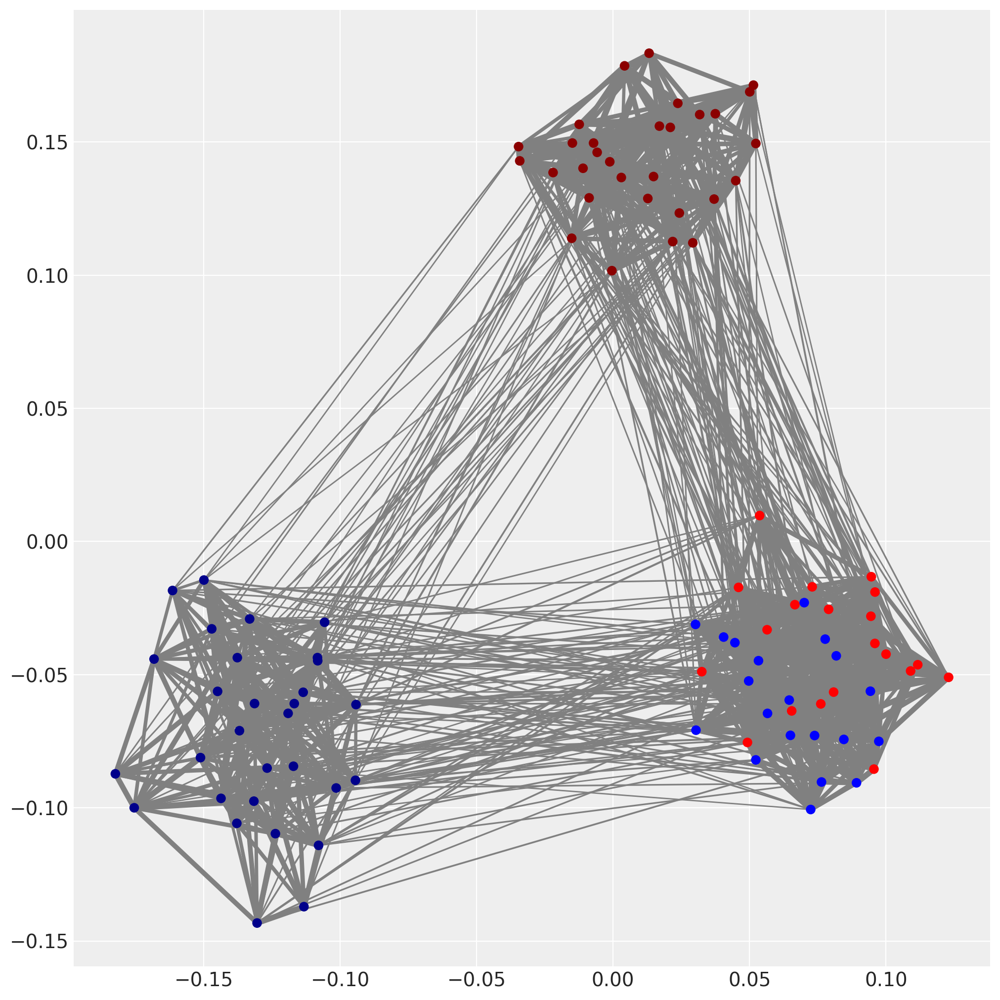

Number of Nodes Migrating to Caesar:
10
Number of Nodes Migrating to Pompey:
10
Top 5 Nodes Most Undecided but Migrated to Caesar:
Node 81 (Migrated with Probability: 0.5189134685195801)
Node 61 (Migrated with Probability: 0.5428990337824886)
Node 79 (Migrated with Probability: 0.5553980851986215)
Node 89 (Migrated with Probability: 0.5578810183628378)
Node 80 (Migrated with Probability: 0.5631837427613354)
Top 5 Nodes Most Undecided but Migrated to Pompey:
Node 82 (Migrated with Probability: 0.5122127257987387)
Node 75 (Migrated with Probability: 0.5203809635383833)
Node 62 (Migrated with Probability: 0.5289959213075545)
Node 66 (Migrated with Probability: 0.5420020301949684)
Node 73 (Migrated with Probability: 0.5525480251032476)


In [ ]:
faction_migration_model_mcmc_ex2, i_data_faction_migration_model_mcmc_ex2 = faction_migration_model_mcmc_approach_0(node_positions_posterior_distance_model_mcmc_ex2, nodes_caesar_ex2, nodes_pompey_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)

os.makedirs(MAIN_FOLDER_PATH + '/Exercise-2', exist_ok=True)
az.to_netcdf(i_data_faction_migration_model_mcmc_ex2, MAIN_FOLDER_PATH + '/Exercise-2/faction_migration_model_mcmc_ex_2.nc')

plot_faction_migrations_ex2(graph_ex2, node_positions_posterior_distance_model_mcmc_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)
sol_nodes_migrating_to_caesar_ex2, sol_nodes_migrating_to_pompey_ex2, sol_csv_nodes_to_caesar_ex2, sol_csv_nodes_to_pompey_ex2 = ex2_0(graph_ex2, node_positions_posterior_distance_model_mcmc_ex2, i_data_faction_migration_model_mcmc_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)

In [ ]:
# Here we compute an accuracy on the half of nodes from the Crassus faction for which we know were they migrated to from the given .csv file.
# We compute what faction would our model predict and compare it with the data from the .csv file.
# We do this as a comparison metric between different approaches (to see which approach could emulate better the observed data).

num_correct_predictions_ex2 = 0
for node in sol_csv_nodes_to_caesar_ex2:
  if node in nodes_migrating_to_caesar_ex2:
    num_correct_predictions_ex2 += 1
for node in sol_csv_nodes_to_pompey_ex2:
  if node in nodes_migrating_to_pompey_ex2:
    num_correct_predictions_ex2 += 1

print('Accuracy Exercise 2 (Only on Given .csv Samples):')
print(num_correct_predictions_ex2 / (len(nodes_migrating_to_caesar_ex2) + len(nodes_migrating_to_pompey_ex2)))

Accuracy Exercise 2 (Only on Given .csv Samples):
0.55


### Second Approach Model Inference for Exercise 2
<br>
<br>
&emsp; We will plot the initial latent 2D representations of the graph. For the Crassus nodes we will color only the nodes for which we know where they migrate to (based on the .csv file).
<br>
&emsp; We obtain the solutions and we plot how the nodes will migrate to the other two factions.

Output()

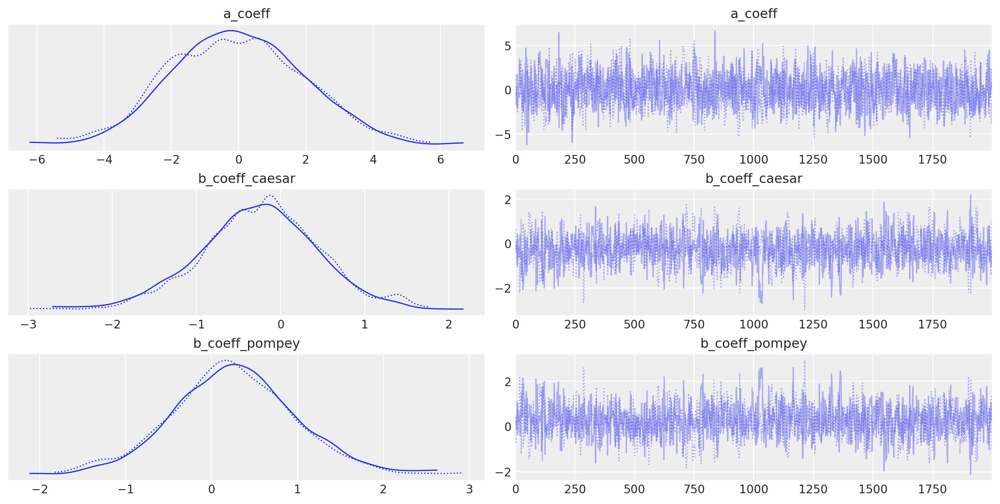

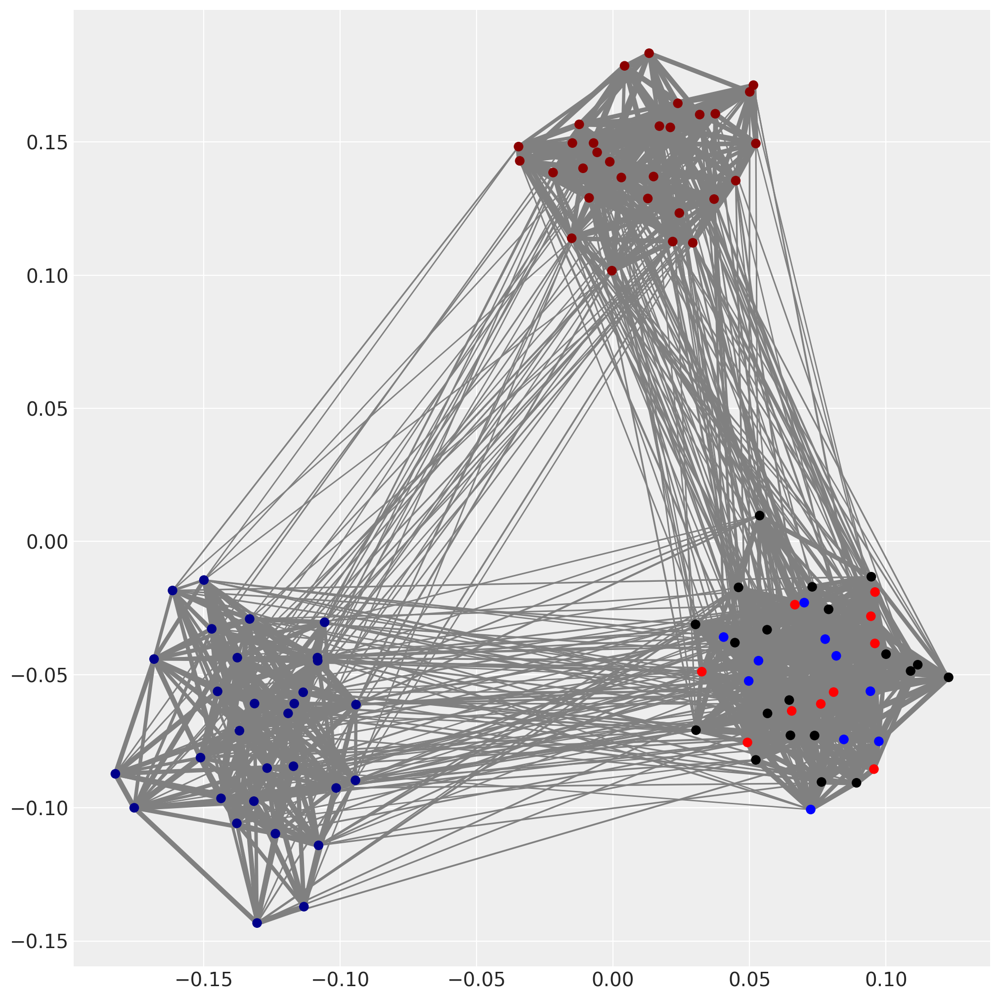

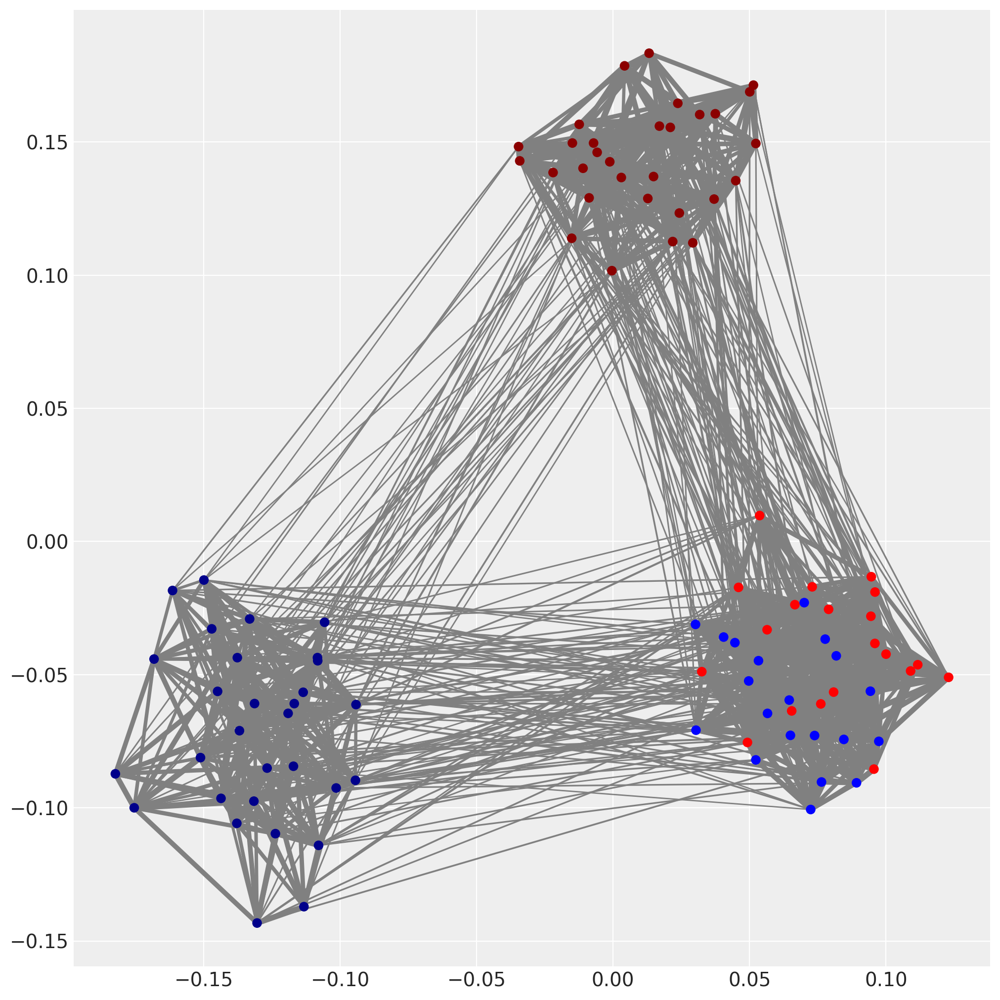

Number of Nodes Migrating to Caesar:
10
Number of Nodes Migrating to Pompey:
10
Top 5 Nodes Most Undecided but Migrated to Caesar:
Node 81 (Migrated with Probability: 0.5127699877412988)
Node 61 (Migrated with Probability: 0.5315674088293414)
Node 79 (Migrated with Probability: 0.5372898378459037)
Node 89 (Migrated with Probability: 0.5397231453189077)
Node 80 (Migrated with Probability: 0.5428670437521603)
Top 5 Nodes Most Undecided but Migrated to Pompey:
Node 82 (Migrated with Probability: 0.5104625379669296)
Node 75 (Migrated with Probability: 0.5164361272118783)
Node 62 (Migrated with Probability: 0.5233450465458519)
Node 66 (Migrated with Probability: 0.5329718494731156)
Node 64 (Migrated with Probability: 0.5405616016288978)


In [ ]:
faction_migration_model_mcmc_ex2, i_data_faction_migration_model_mcmc_ex2 = faction_migration_model_mcmc_approach_1(node_positions_posterior_distance_model_mcmc_ex2, nodes_caesar_ex2, nodes_pompey_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)

os.makedirs(MAIN_FOLDER_PATH + '/Exercise-2', exist_ok=True)
az.to_netcdf(i_data_faction_migration_model_mcmc_ex2, MAIN_FOLDER_PATH + '/Exercise-2/faction_migration_model_mcmc_ex_2.nc')

plot_faction_migrations_ex2(graph_ex2, node_positions_posterior_distance_model_mcmc_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)
sol_nodes_migrating_to_caesar_ex2, sol_nodes_migrating_to_pompey_ex2, sol_csv_nodes_to_caesar_ex2, sol_csv_nodes_to_pompey_ex2 = ex2_1(graph_ex2, node_positions_posterior_distance_model_mcmc_ex2, i_data_faction_migration_model_mcmc_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)

In [ ]:
# Here we compute an accuracy on the half of nodes from the Crassus faction for which we know were they migrated to from the given .csv file.
# We compute what faction would our model predict and compare it with the data from the .csv file.
# We do this as a comparison metric between different approaches (to see which approach could emulate better the observed data).

num_correct_predictions_ex2 = 0
for node in sol_csv_nodes_to_caesar_ex2:
  if node in nodes_migrating_to_caesar_ex2:
    num_correct_predictions_ex2 += 1
for node in sol_csv_nodes_to_pompey_ex2:
  if node in nodes_migrating_to_pompey_ex2:
    num_correct_predictions_ex2 += 1

print('Accuracy Exercise 2 (Only on Given .csv Samples):')
print(num_correct_predictions_ex2 / (len(nodes_migrating_to_caesar_ex2) + len(nodes_migrating_to_pompey_ex2)))

Accuracy Exercise 2 (Only on Given .csv Samples):
0.5


### Third Approach Model Inference for Exercise 2
<br>
<br>
&emsp; We will plot the initial latent 2D representations of the graph. For the Crassus nodes we will color only the nodes for which we know where they migrate to (based on the .csv file).
<br>
&emsp; We obtain the solutions and we plot how the nodes will migrate to the other two factions.

Output()

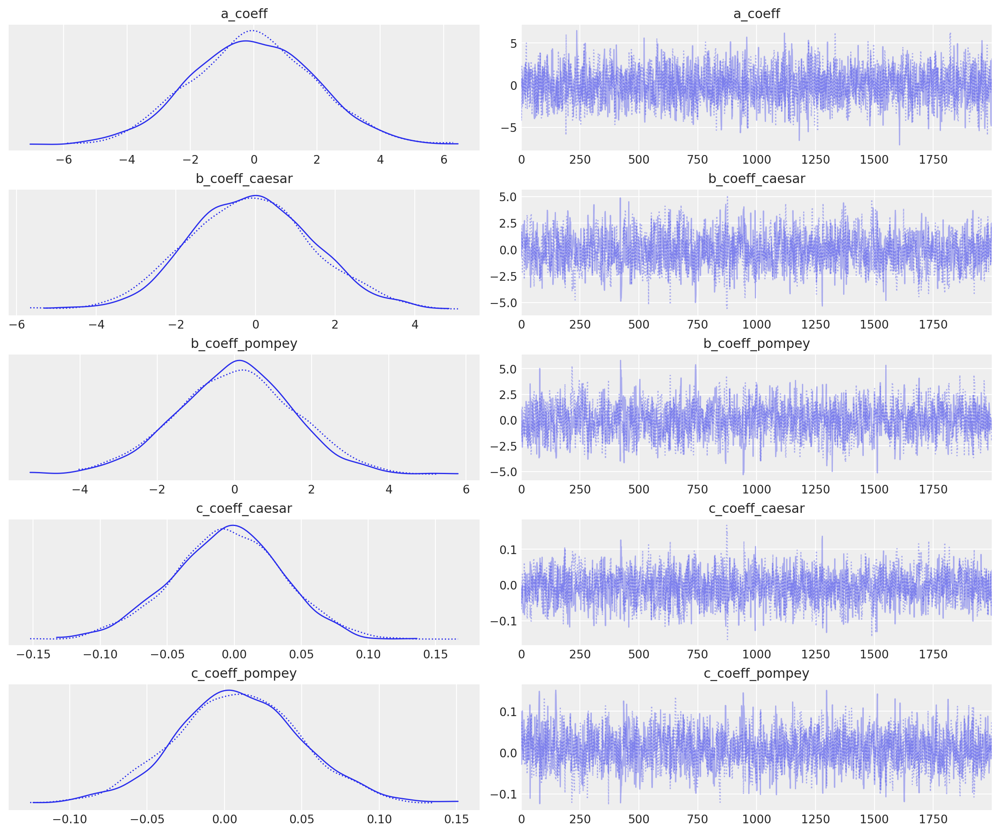

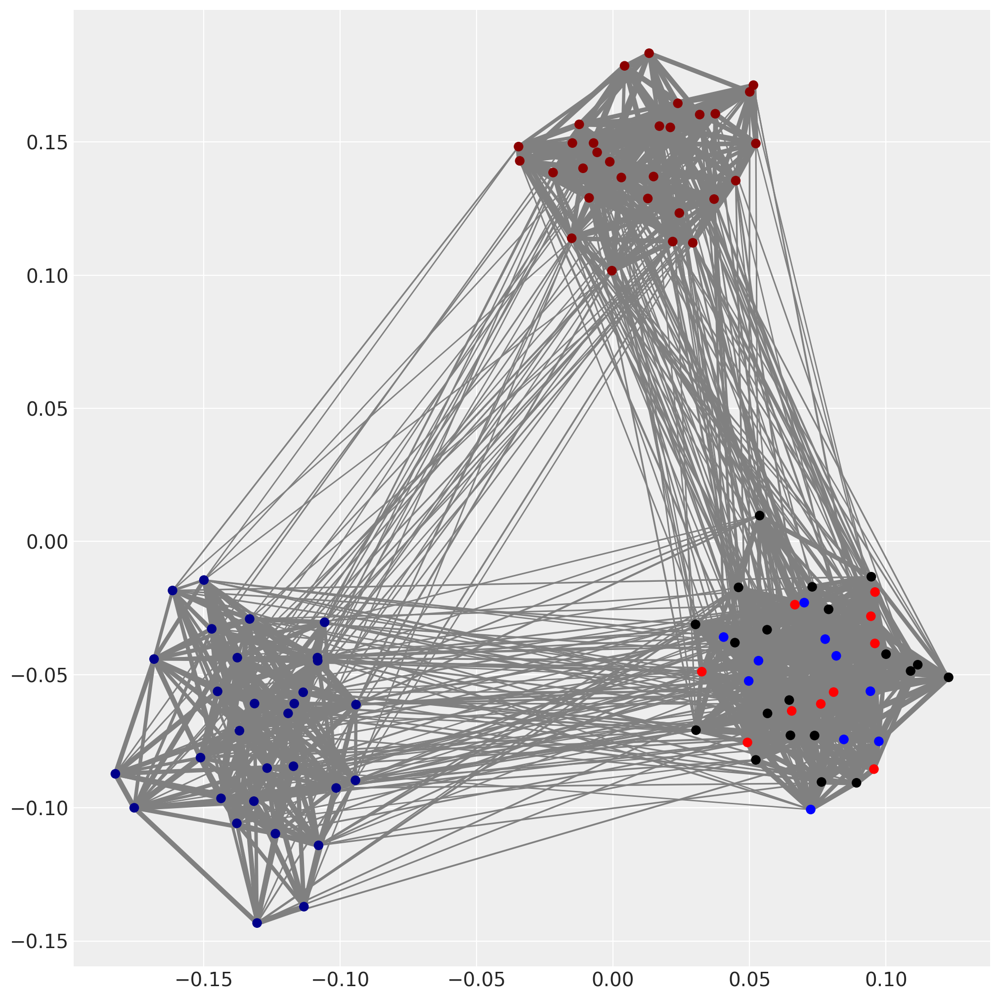

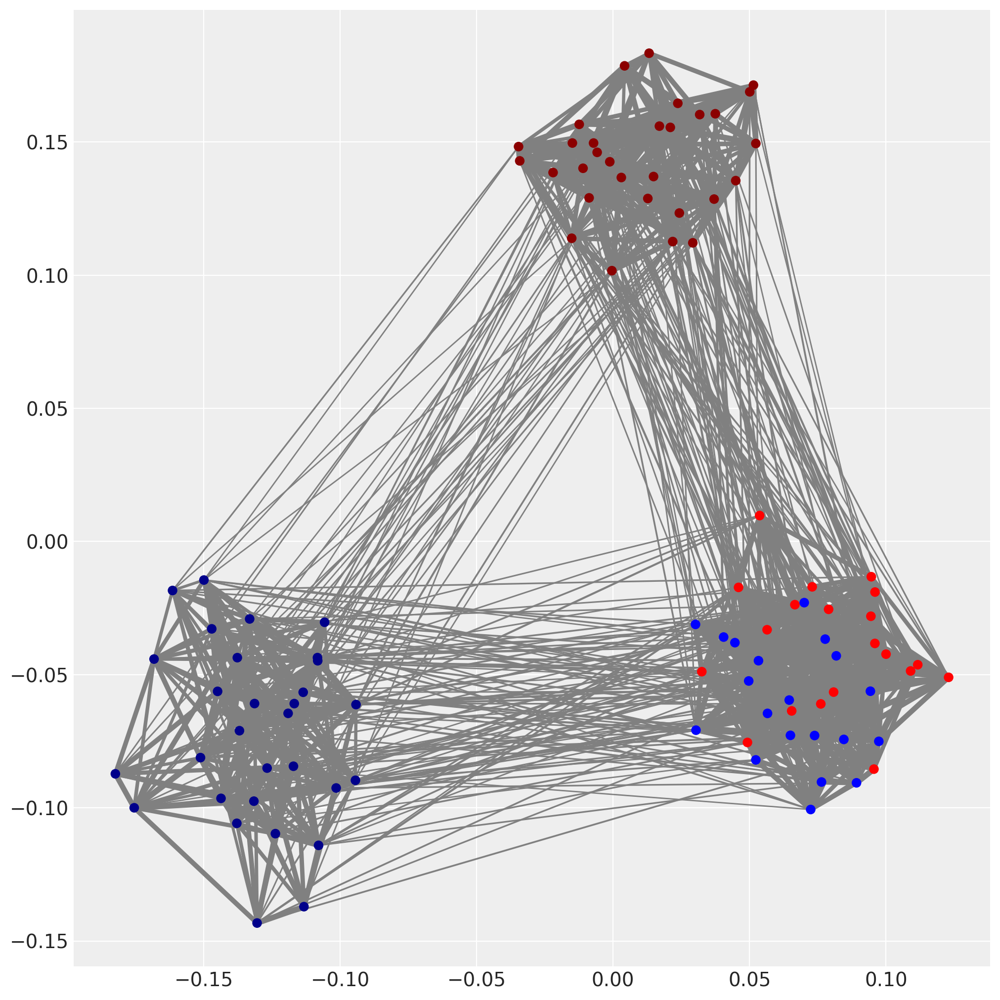

Number of Nodes Migrating to Caesar:
10
Number of Nodes Migrating to Pompey:
10
Top 5 Nodes Most Undecided but Migrated to Caesar:
Node 81 (Migrated with Probability: 0.51022532461717)
Node 61 (Migrated with Probability: 0.5344497595158184)
Node 89 (Migrated with Probability: 0.5694940787574145)
Node 79 (Migrated with Probability: 0.5697005089372531)
Node 98 (Migrated with Probability: 0.5758291745466517)
Top 5 Nodes Most Undecided but Migrated to Pompey:
Node 82 (Migrated with Probability: 0.5306139931747237)
Node 62 (Migrated with Probability: 0.5393221166335241)
Node 75 (Migrated with Probability: 0.5467825697092155)
Node 66 (Migrated with Probability: 0.5479375166591707)
Node 64 (Migrated with Probability: 0.549646190025441)


In [ ]:
faction_migration_model_mcmc_ex2, i_data_faction_migration_model_mcmc_ex2 = faction_migration_model_mcmc_approach_2(node_positions_posterior_distance_model_mcmc_ex2, nodes_caesar_ex2, nodes_pompey_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)

os.makedirs(MAIN_FOLDER_PATH + '/Exercise-2', exist_ok=True)
az.to_netcdf(i_data_faction_migration_model_mcmc_ex2, MAIN_FOLDER_PATH + '/Exercise-2/faction_migration_model_mcmc_ex_2.nc')

plot_faction_migrations_ex2(graph_ex2, node_positions_posterior_distance_model_mcmc_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)
sol_nodes_migrating_to_caesar_ex2, sol_nodes_migrating_to_pompey_ex2, sol_csv_nodes_to_caesar_ex2, sol_csv_nodes_to_pompey_ex2 = ex2_2(graph_ex2, node_positions_posterior_distance_model_mcmc_ex2, i_data_faction_migration_model_mcmc_ex2, nodes_migrating_to_caesar_ex2, nodes_migrating_to_pompey_ex2)

In [ ]:
# Here we compute an accuracy on the half of nodes from the Crassus faction for which we know were they migrated to from the given .csv file.
# We compute what faction would our model predict and compare it with the data from the .csv file.
# We do this as a comparison metric between different approaches (to see which approach could emulate better the observed data).

num_correct_predictions_ex2 = 0
for node in sol_csv_nodes_to_caesar_ex2:
  if node in nodes_migrating_to_caesar_ex2:
    num_correct_predictions_ex2 += 1
for node in sol_csv_nodes_to_pompey_ex2:
  if node in nodes_migrating_to_pompey_ex2:
    num_correct_predictions_ex2 += 1

print('Accuracy Exercise 2 (Only on Given .csv Samples):')
print(num_correct_predictions_ex2 / (len(nodes_migrating_to_caesar_ex2) + len(nodes_migrating_to_pompey_ex2)))

Accuracy Exercise 2 (Only on Given .csv Samples):
0.55


## Answers Exercise 2:

For answering these two questions, we used the third approach (quadratic combination of distances to the other 2 factions).

Q1: Who gathered more politicians from Crassus' faction?
<br>
Answer:
<br>
Number of Nodes Migrating to Caesar: 10 (excluding politicians from .csv file)
<br>
Number of Nodes Migrating to Pompey: 10 (excluding politicians from .csv file)
<br>
Both Factions have gathered same number of politicians.

Q2: Who are the most undecided politicians when it comes to choosing between Caesar and Pompey?
<br>
Answer:
<br>
<br>
Top 5 Nodes Most Undecided but Migrated to Caesar:
<br>
<br>
Node 81 (Migrated with Probability: 0.51022532461717)
<br>
Node 61 (Migrated with Probability: 0.5344497595158184)
<br>
Node 89 (Migrated with Probability: 0.5694940787574145)
<br>
Node 79 (Migrated with Probability: 0.5697005089372531)
<br>
Node 98 (Migrated with Probability: 0.5758291745466517)
<br>
<br>
<br>
<br>
Top 5 Nodes Most Undecided but Migrated to Pompey:
<br>
<br>
Node 82 (Migrated with Probability: 0.5306139931747237)
<br>
Node 62 (Migrated with Probability: 0.5393221166335241)
<br>
Node 75 (Migrated with Probability: 0.5467825697092155)
<br>
Node 66 (Migrated with Probability: 0.5479375166591707)
<br>
Node 64 (Migrated with Probability: 0.549646190025441)